# CDI

## Lib import

In [1]:
import numpy as np
import cupy as cp
import cupyx.scipy.ndimage as cndimage
from numba import njit,prange

from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import imageio

from functools import wraps
from dataclasses import dataclass
from typing import Tuple, Dict, Any,List

import secrets

import cProfile
import pstats

from skimage.measure import shannon_entropy

## Image drawing decorators

In [2]:
def validate(*arg_positions):
  """Error checking"""
  def decorator(f):
      @wraps(f)
      def wrapper(*args, **kwargs):
          for pos in arg_positions:
              if pos < len(args) and not isinstance(args[pos], np.ndarray):
                  raise ValueError(f"{pos} must be numpy")
          return f(*args, **kwargs)
      return wrapper
  return decorator

def plot_image(data, ax=None, **kwargs):
  """
  Basic function for image drawing.

  Parameters:
      data: np.ndarray
      ax: matplotlib axis (if None, new axis is created)
      **kwargs: dictionary of imshow parameters

  """
  if ax is None:
      ax = plt.gca()

  # here grey colormap, auto aspect ratio are defined
  # and [0,0] index of the array is placed the lower-left corner

  imshow_kwargs = {
      'cmap': kwargs.get('cmap', 'grey'),
      'aspect': kwargs.get('aspect', 'auto'),
      'origin': kwargs.get('origin', 'lower')
  }

  if data.ndim == 3 and data.shape[2] == 3:
      imshow_kwargs.pop('cmap', None)

  img = ax.imshow(data, **imshow_kwargs)
  ax.set_title(kwargs.get('title', ''))

  if kwargs.get('colorbar', True):
      plt.colorbar(img, ax=ax)

  return ax

# then decorators can be applied for showing different number of images

@validate(0)
def show_1_image(data, **kwargs):
  """Plots 1 image using kwargs"""
  plt.figure(figsize=kwargs.get('figsize', (6, 6)))
  plot_image(data, **kwargs)
  plt.tight_layout()
  plt.show()

# the most useful one

@validate(0, 1)
def show_2_images(data1, data2, **kwargs):
  """Plots 2 images using kwargs"""
  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=kwargs.get('figsize', (12, 6)))

  plot_image(data1, ax=ax1,
            title=kwargs.get('title1', 'Module'),
            cmap=kwargs.get('cmap1', 'grey'),
            **kwargs)

  plot_image(data2, ax=ax2,
            title=kwargs.get('title2', 'Phase'),
            cmap=kwargs.get('cmap2', 'grey'),
            **kwargs)

  if 'suptitle' in kwargs:
      fig.suptitle(kwargs['suptitle'])

  plt.tight_layout()
  plt.show()

## Classes for image processing and phase retrieval

In [3]:
@dataclass
class ExperimentalConf:

  '''
  Experimental setup determination
  and establishing image properties

  Parametets:
      z_um: distance between object and detector [um]
      lambda_um: wavelenght [um]
      noise_threshold: noise threshold. In next code version will be calculated.
      detector_width_um: detector's width [um]
      detector_height_um: detector's height [um]
      mask_width_um: width of the mask for retrieval [um]
      mask_height_um: height of the mask for retrieval [um]
      mask_x_offset_um: horizontal offset of the mask's center [um]
      mask_y_offset_um: vertical offset of the mask's center [um]
      rotation_angle: angle of the image rotation
      image_path: path of the image's file

  '''

  # These parameters are defined for the certain setup;
  # you can change them during defining your object

  z_um: float = 6e5
  lambda_um: float = 0.6328
  noise_threshold: int = 77#34
  detector_width_um: float = 0.618 * 1e4
  detector_height_um: float = 0.7728 * 1e4
  mask_width_um: float = 3000#2.3 * 1e3
  mask_height_um: float = 3200#2.2 * 1e3
  mask_x_offset_um: float = 0.0
  mask_y_offset_um: float = 0#100
  rotation_angle: int = 90
  image_path: str = '3.tif'

  _cached_properties: Dict[str, Any] = None

  def __post_init__(self):
      self._cached_properties = {}

  def _get_or_compute(self, key: str, compute_func):
      if key not in self._cached_properties:
          self._cached_properties[key] = compute_func()
      return self._cached_properties[key]

  @property
  def image_size(self) -> Tuple[int, int]:
      '''Returns the size of the image (widht, height) in px'''

      return self._get_or_compute('image_size', lambda: (
          (lambda img: (img.width, img.height) if self.rotation_angle in (90, 270) else (img.height, img.width))(
              Image.open(self.image_path) )))

  @property
  def pixel_size(self) -> Tuple[float, float]:
      '''Returns the size of a pixel (dx, dy) in um/px'''

      return self._get_or_compute('pixel_size', lambda: (
          self.detector_height_um / self.image_size[0],
          self.detector_width_um / self.image_size[1]))

  @property
  def mask_offset(self) -> Tuple[int, int]:
      '''Returns (offset_x_px, offset_y_px) in px'''

      dy, dx = self.pixel_size
      return (
          int(self.mask_x_offset_um / dx),
          int(self.mask_y_offset_um / dy) )

  @property
  def scale_factors(self) -> Tuple[float, float]:
      '''Scale factors for affine_transform'''

      dx, dy = self.pixel_size
      return (
          (self.lambda_um * self.z_um) / (self.detector_width_um * dx),
          (self.lambda_um * self.z_um) / (self.detector_height_um * dy))



In [4]:
class ImageProcessor:
  '''
  Image preparation

  Parameters:
      k: wavenumber [1/um]
  '''

  def __init__(self, config: ExperimentalConf):
      self.config = config
      self.k = 2 * np.pi / self.config.lambda_um


  def load(self) -> np.ndarray:
      '''Loading;
          Returns numpy-array'''

      img = np.flipud(np.array(
          Image.open(self.config.image_path).rotate(self.config.rotation_angle, expand=True)
      ))
      return img

  @staticmethod
  def sigma_clip_threshold(image, sigma_clip: float = 3.0, max_iter: int = 5, eps: float = 1e-12):
      arr = np.asarray(image).ravel()
      mask = np.ones_like(arr, dtype=bool)
      for _ in range(int(max_iter)):
          subset = arr[mask]
          if subset.size == 0:
              break
          med = np.median(subset)
          mad = np.median(np.abs(subset - med))
          sigma = mad * 1.4826
          if sigma <= eps:
              break
          new_mask = np.abs(arr - med) < (sigma_clip * sigma)
          if np.array_equal(new_mask, mask):
              break
          mask = new_mask
      if mask.sum() == 0:
          return float(np.median(arr))
      med_bg = float(np.median(arr[mask]))
      mad_bg = float(np.median(np.abs(arr[mask] - med_bg)))
      sigma_bg = mad_bg * 1.4826
      return [med_bg + sigma_clip * sigma_bg, float(arr[mask].mean())]

  def preprocess(self, scale_flag:bool=True) -> cp.ndarray:
      '''Preprocessing: cleaning, scaling;
          Returns cupy-array'''

      img = self.load()
      noise = self.sigma_clip_threshold(img)[1]
      clean = np.where(img < noise, 0, img - noise)
      if scale_flag:
          return cp.asarray(np.sqrt(clean) * self.config.z_um / (2 * np.pi * self.k))
      else:
          return cp.asarray(np.sqrt(clean))

  def generate_random_complex_field(self) ->cp.ndarray:
      '''Generates 2D random complex distribution'''

      height, width=self.config.image_size
      rand_field = np.empty((height, width), dtype=np.complex64)
      amplitudes = np.empty((height, width))
      phases = np.empty((height, width))
      for i in prange(height):
          for j in range(width):
              amplitudes[i,j] = secrets.randbits(32) / 2**32
              phases[i,j] = secrets.randbits(32) / 2**32 * 2 * np.pi
      rand_field = amplitudes * np.exp(1j * phases)
      return cp.asarray(rand_field)

  def create_mask(self) -> cp.ndarray:
      '''Generates initial mask for the phase retrieval algorithm'''

      height, width = self.config.image_size
      dx, dy = self.config.pixel_size
      offset_px, offset_py = self.config.mask_offset

      mask = cp.zeros((height, width), dtype=cp.float64)
      mask_width_px = int(self.config.mask_width_um / dx)
      mask_height_px = int(self.config.mask_height_um / dy)

      start_x = (width // 2 - offset_px) - (mask_width_px // 2)
      start_y = (height // 2 - offset_py) - (mask_height_px // 2)

      mask[start_y:start_y + mask_height_px, start_x:start_x + mask_width_px] = 1.0
      return mask

  def create_phase_exp(self) ->cp.ndarray:
      '''Creates phase factor for virtual lens'''

      height, width = self.config.image_size
      dx, dy = self.config.pixel_size
      offset_px, offset_py = self.config.mask_offset

      x = (cp.arange(width) - (width//2) + offset_px ) * dx
      y = (cp.arange(height) - (height // 2) + offset_py) * dy
      X, Y = cp.meshgrid(x, y)
      r_sq = X**2 + Y**2

      phase = 1j * self.k * r_sq / (2 * self.config.z_um)
      return cp.exp(phase)

  def apply_affine_scale(self) -> cp.ndarray:
      '''Distorts image with scale factors for virtual lens'''

      kx, ky = self.config.scale_factors
      img = self.load()
      img = self.preprocess(scale_flag=True)
      h, w = img.shape

      offset_px, offset_py = self.config.mask_offset

      matrix = cp.array([[ky, 0], [0, kx]])
      offset = cp.array([h, w]) * (1 - cp.array([ky, kx])) // 2-cp.array([offset_py,offset_px])
      return cndimage.affine_transform(img,matrix,offset=offset,order=5,output_shape=(h, w))


In [5]:
class PhaseRetriever(ImageProcessor):
  '''

  Child class for phase retrieval

  Parameters:
      flag_prop: if True, virtual lens is applied.
      In opposite case wave propagator will be used.

  '''
  def __init__(self, config: ExperimentalConf):
      super().__init__(config)
      self._phase_exp = self.create_phase_exp()
      self.mask = self.create_mask()
      self.flag_prop=False

  @property
  def phase_exp(self) -> cp.ndarray:
      return self._phase_exp

  def ft(self, data: np.ndarray) -> cp.ndarray:
      '''Forier transform'''

      data_gpu = cp.asarray(data, dtype=np.complex64)
      return cp.fft.fftshift(cp.fft.fft2(cp.fft.ifftshift(data_gpu)))

  def ift(self, data: np.ndarray) -> cp.ndarray:
      '''Inverse Forier transform'''

      data_gpu = cp.asarray(data, dtype=np.complex64)
      return cp.fft.fftshift(cp.fft.ifft2(cp.fft.ifftshift(data_gpu)))

  def prop(self, field:np.ndarray,Z:float) ->cp.ndarray:
      '''Wave propagator'''

      field_1 = self.ft(field)
      field_1 = cp.fft.ifftshift(field_1)
      n, m = field_1.shape
      fx = cp.fft.fftfreq(n)
      fy = cp.fft.fftfreq(m)
      px, py = cp.meshgrid(fx, fy, indexing='ij')
      p_squared = px**2 + py**2  # Squared magnitude of spatial frequencies
      field_1 = field_1 * cp.exp(1j * Z * cp.sqrt(self.k**2 - p_squared))
      field_1 = cp.fft.ifftshift(field_1)
      field_1=self.ift(field_1)
      return field_1

  def step(self, field: cp.ndarray, detector: np.ndarray) -> cp.ndarray:
      '''Propagation & Fourier constraint;
          a building block for ER/HIO'''

      X_1=cp.asarray(field)
      flag_prop=self.flag_prop
      if flag_prop:
        X_2=self.prop(cp.asnumpy(X_1),Z=self.config.z_um) # wave propagator (to detector)
      else:
        X_2=self.ft(X_1*self.phase_exp) # virtual lens (to detector)
      X_2=X_2/cp.max(X_2)
      X_3=cp.asarray(detector)*X_2/cp.abs(X_2) # Forier constraint
      if flag_prop:
        X_4=self.prop(X_3,Z=-self.config.z_um) # backward direction (to object)
      else:
        X_4=self.ift(X_3)/self.phase_exp # backward direction (to object)
      X_out=X_4/cp.max(X_4)
      return X_out

  def ER(self,n_iter: int, field: cp.ndarray, detector: np.ndarray, MASK:cp.ndarray) -> Tuple[cp.ndarray, float]:
      '''Error Reduction'''

      field_1 = cp.asarray(field)
      for _ in range(n_iter):
          d = self.step(field=field_1,detector=detector)
          field_1 = MASK*d # Object constraint


      # Error estimation
      error=shannon_entropy(cp.asnumpy(field_1))-1.
      #error=cp.sqrt(1.)
      '''
      if self.flag_prop:
        gk=self.prop(cp.asnumpy(field_1),Z=self.config.z_um)
      else:
        gk=self.ft(field_1*self.phase_exp)
      d_norm=cp.linalg.norm(detector)
      gk_norm = cp.linalg.norm(gk)
      n,m=gk.shape


      error = cp.sqrt(np.abs(gk_norm**2 - d_norm**2))/n/m
      #d_norm = cp.linalg.norm(d)
      #a_norm = cp.linalg.norm(field_1)
      #error = cp.sqrt(d_norm**2 - a_norm**2) / d_norm
      '''

      return cp.asnumpy(field_1), float(error)

  def HIO(self, n_iter: int, field: cp.ndarray, detector: np.ndarray, beta: float, MASK:cp.ndarray) -> cp.ndarray:
      '''Hybrid Input-Output'''

      field_1 = cp.asarray(field)
      for _ in range(n_iter):
          d = self.step(field=field_1,detector=detector)
          field_1 = MASK*d +(field_1 - beta * d)*(1.0-MASK) # Object constraint
      return cp.asnumpy(field_1)

  def retrieving(self,DET:np.ndarray, FLD:np.ndarray, beta:float, MASK,
                  hio_iters: int = 30, er_iters: int = 10)->Tuple[np.ndarray, float]:
      '''HIO/ER block'''

      # FLD is the r-domain field for the HIO's 0th iteration, DET --- detector's magnitude
      c_hio = self.HIO(n_iter=hio_iters, beta=beta, field=FLD, detector=DET,MASK=MASK)
      # c_hio field (in r-domain), now put it into 0th iteration for ER
      c_er,err = self.ER(n_iter=er_iters, field=c_hio, detector=DET,MASK=MASK)
      return [c_er,err]

  def retr_block(self, detector: np.ndarray, initial_field: np.ndarray, MASK,
              hio_iters: int = 30, er_iters: int = 10,betas:List=[0.7,0.4,0.1]) -> Tuple[np.ndarray, float]:

      '''
      Phase retrival cycle

      ############################################################
      # This algorithm is taken from the work:                   #
        # Artyukov, I.A., Vinogradov, A.V., Gorbunkov, M.V. et al. #
      # Virtual Lens Method for Near-Field Phase Retrieval.      #
      # Bull. Lebedev Phys. Inst. 50, 414–419 (2023).            #
      # https://doi.org/10.3103/S1068335623100020                #
      ############################################################

      Parameters:
          detector: Detector's image [numpy array]
          initial_field: Initial field (firstly it's random) [numpy array]
          hio_iters: Number of HIO's iterations for each beta value
          er_iters: Number of ER's iterations for each beta value

      Returns:
          Retrieved field and error
      '''

      current_field = cp.asarray(initial_field)
      error = 0.
      current_field,error = self.retrieving(DET=detector,FLD=current_field,beta=1.0,MASK=MASK)
      for beta in betas:
          current_field,error=self.retrieving(DET=detector,FLD=current_field,beta=beta,MASK=MASK)
      return cp.asnumpy(current_field), error

## Data loading

Type (must be uint16): uint16
Image size [Height, Width] (px): (1288, 1030)
Pixel size (um): (6.0, 6.0)
Mask offset (px): (0, 0)
(10.239482200647249, 8.18840579710145)
noise:  77.4446166174374


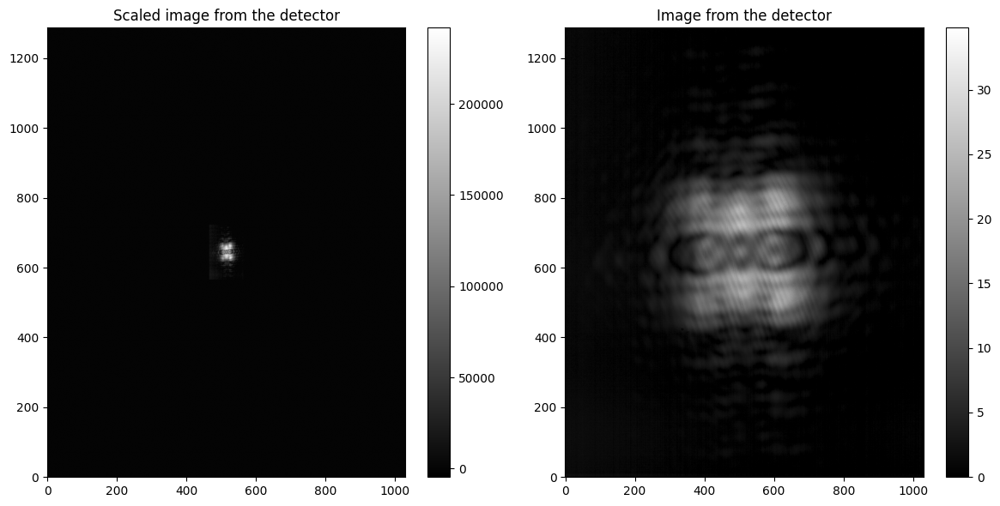

In [6]:
letter_F_config = ExperimentalConf(image_path="2.tif")
F_processor = ImageProcessor(letter_F_config)

#CHECK#
print("Type (must be uint16):", np.asarray(Image.open(letter_F_config.image_path)).dtype)
print("Image size [Height, Width] (px):", F_processor.config.image_size)
print("Pixel size (um):", F_processor.config.pixel_size)
print("Mask offset (px):", F_processor.config.mask_offset)
print(letter_F_config.scale_factors)

detector_F_data_wp=F_processor.load()
print("noise: ",F_processor.sigma_clip_threshold(detector_F_data_wp)[1])
detector_F_data_wp=F_processor.preprocess(scale_flag=False)
detector_F_data_vl=F_processor.apply_affine_scale()
show_2_images(cp.asnumpy(detector_F_data_vl),cp.asnumpy(detector_F_data_wp),
              title1="Scaled image from the detector",title2="Image from the detector")
VL_F=PhaseRetriever(letter_F_config)
WP_F=PhaseRetriever(letter_F_config)
WP_F.flag_prop=True

initial_field = F_processor.generate_random_complex_field()

## Image morphology functions

In [7]:
def dilate(image, iterations:int=1, kernel_size:int=3):
  image_gpu = cp.asarray(image)
  kernel = cp.ones((kernel_size, kernel_size), dtype=bool)
  for _ in range(iterations):
      image_gpu = cndimage.binary_dilation(image_gpu, structure=kernel)
  return image_gpu

def erode(image, iterations:int=1, kernel_size:int=3):
  image_gpu = cp.asarray(image)
  kernel = cp.ones((kernel_size, kernel_size), dtype=bool)
  for _ in range(iterations):
      image_gpu = cndimage.binary_erosion(image_gpu, structure=kernel)
  return image_gpu

## Phase retrieval with adaptive mask

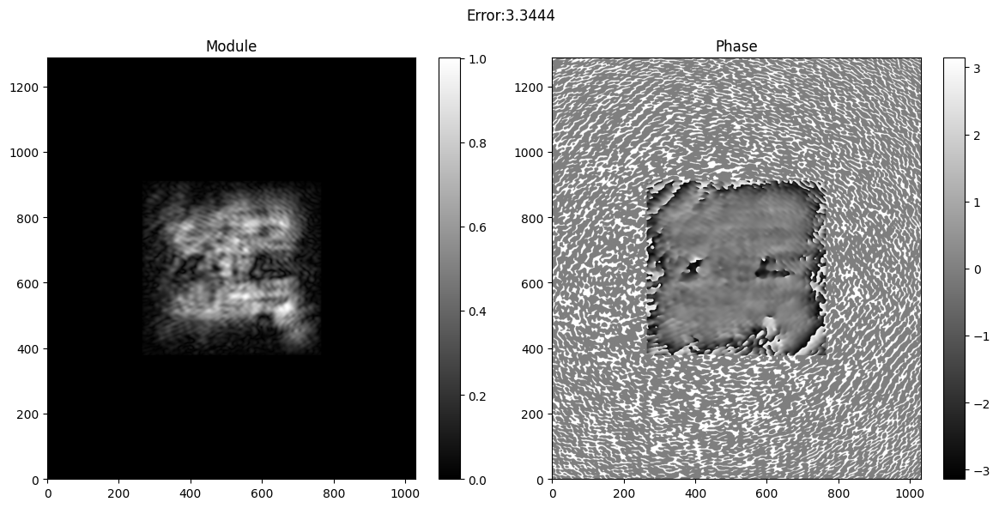

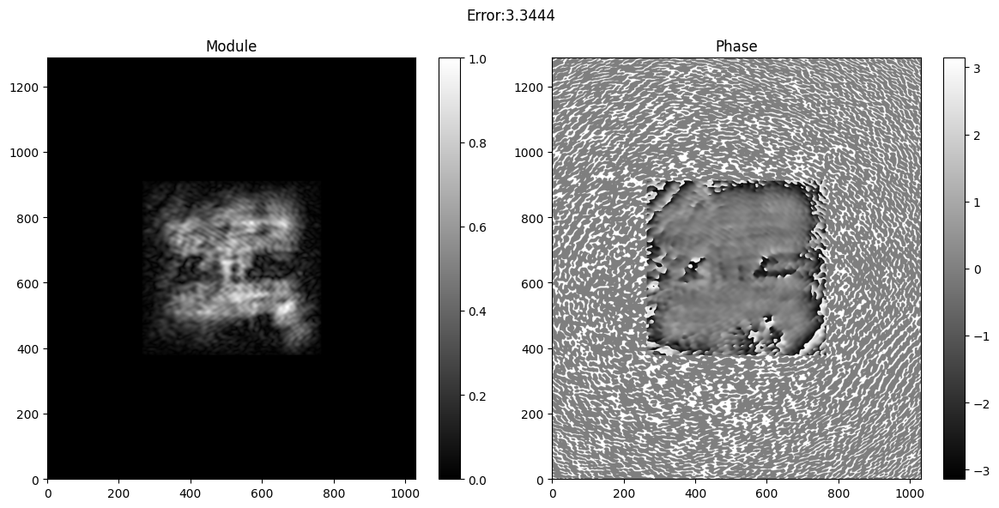

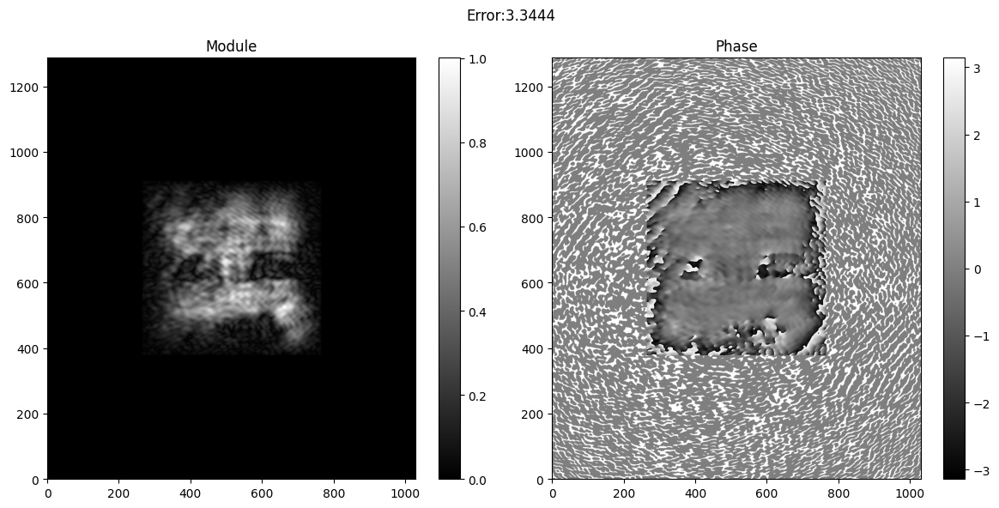

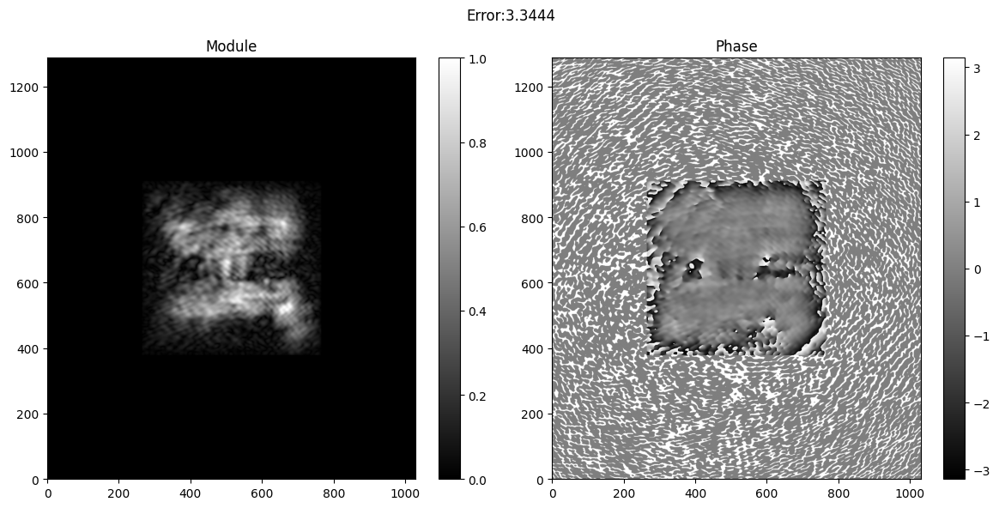

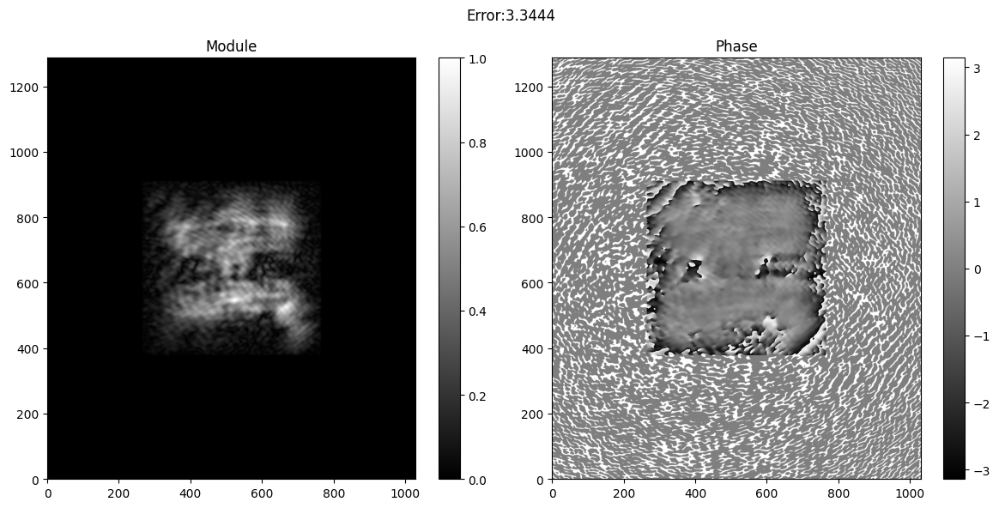

...

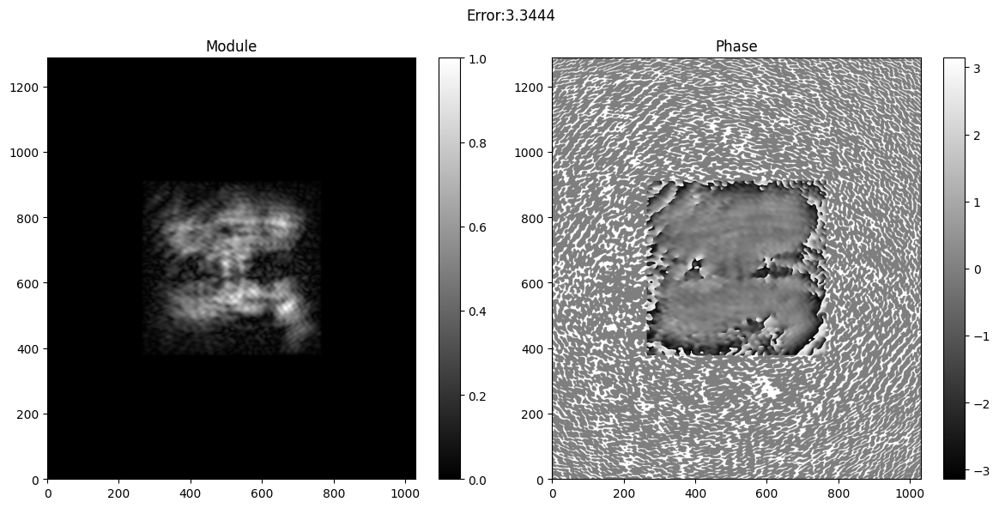

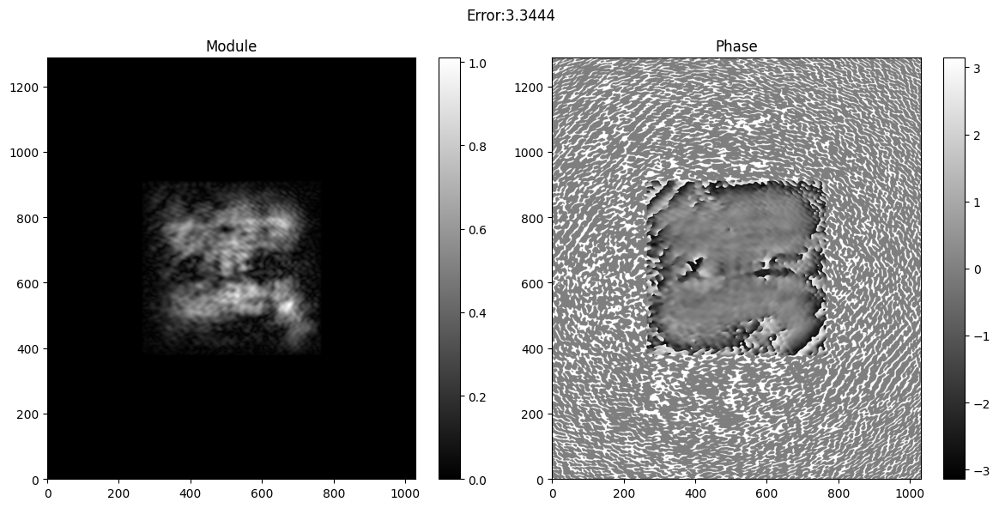

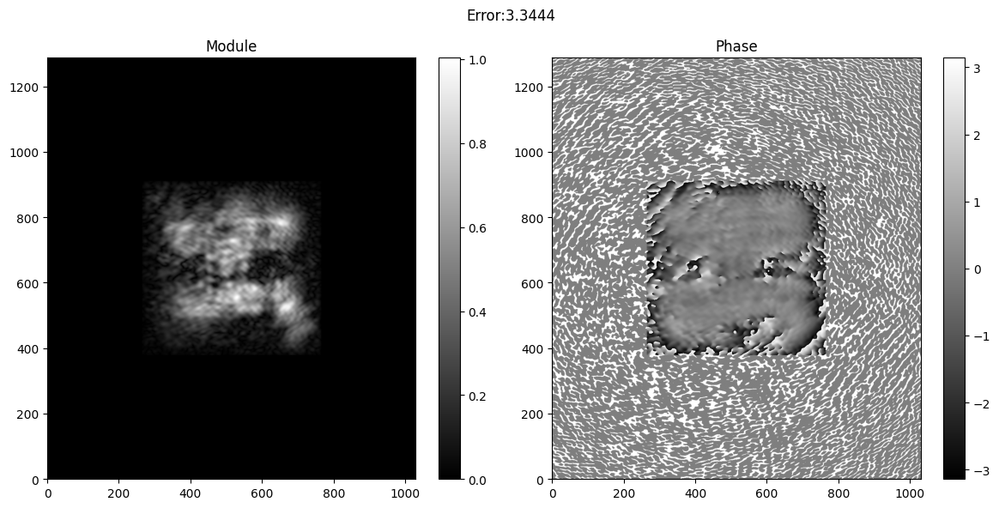

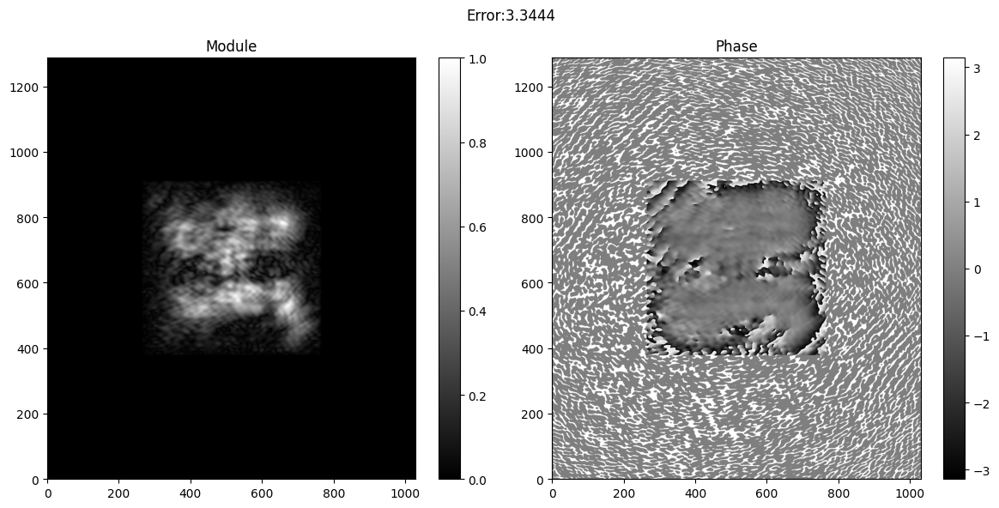

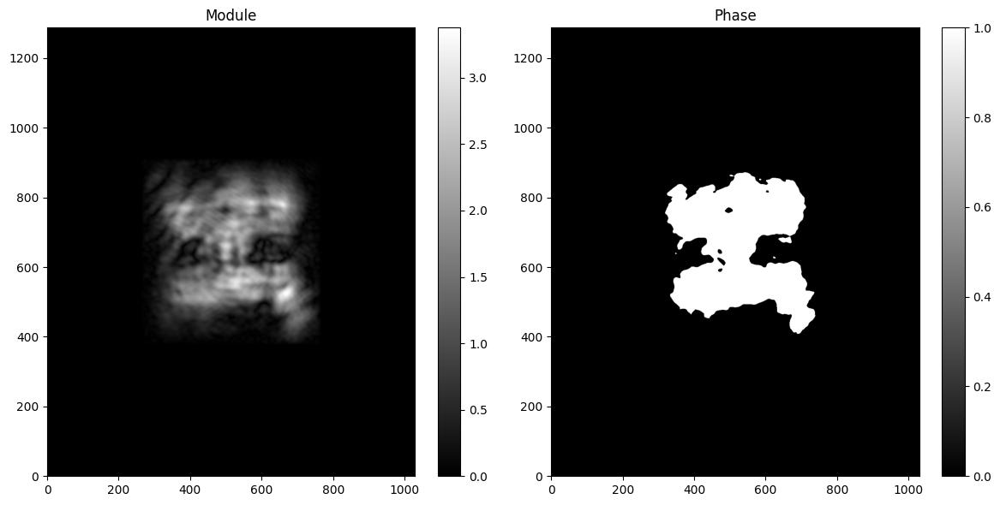

Число итераций эрозии:
2
Число итераций дилатации
25


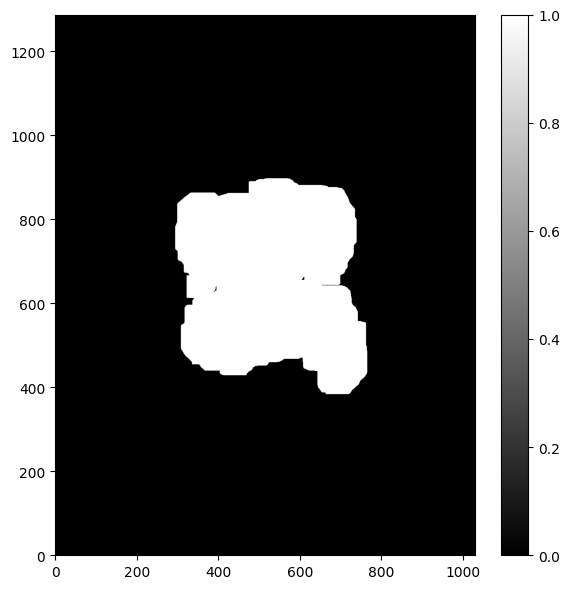

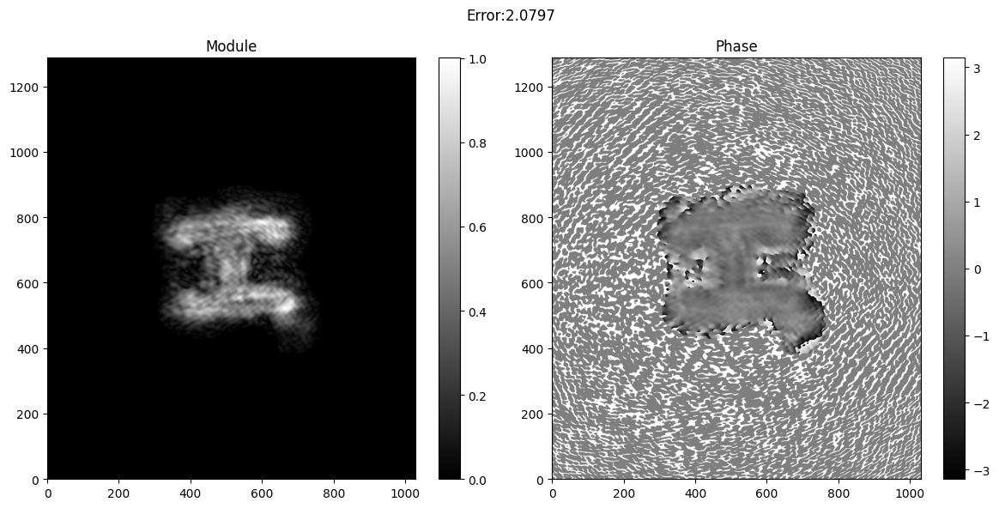

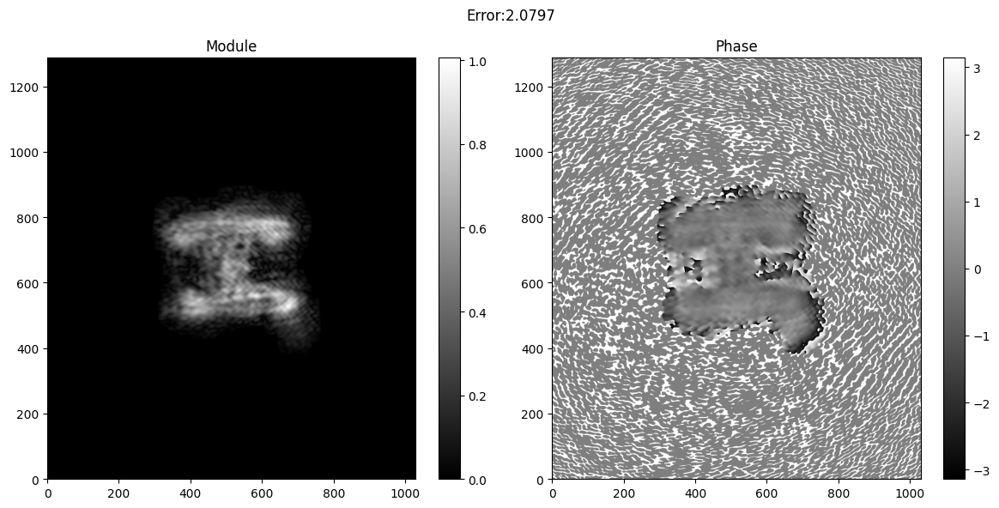

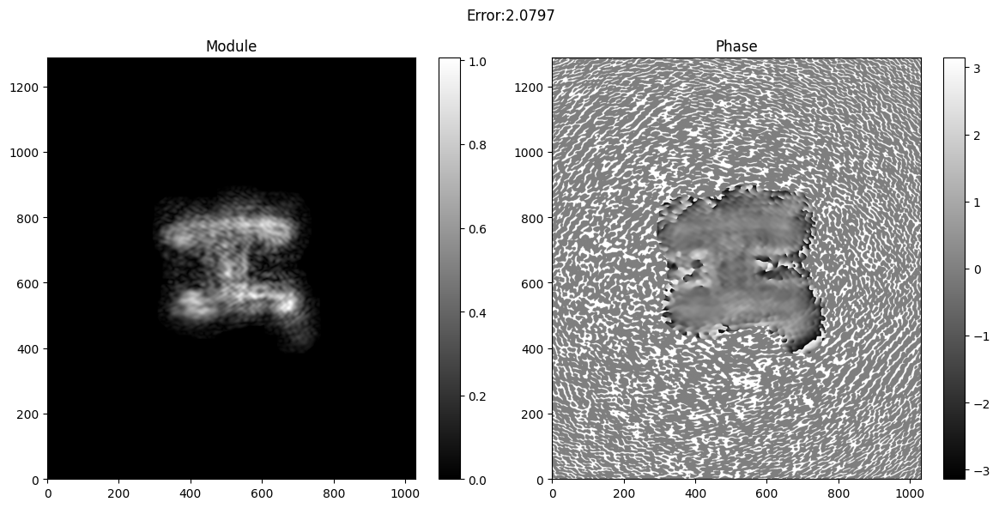

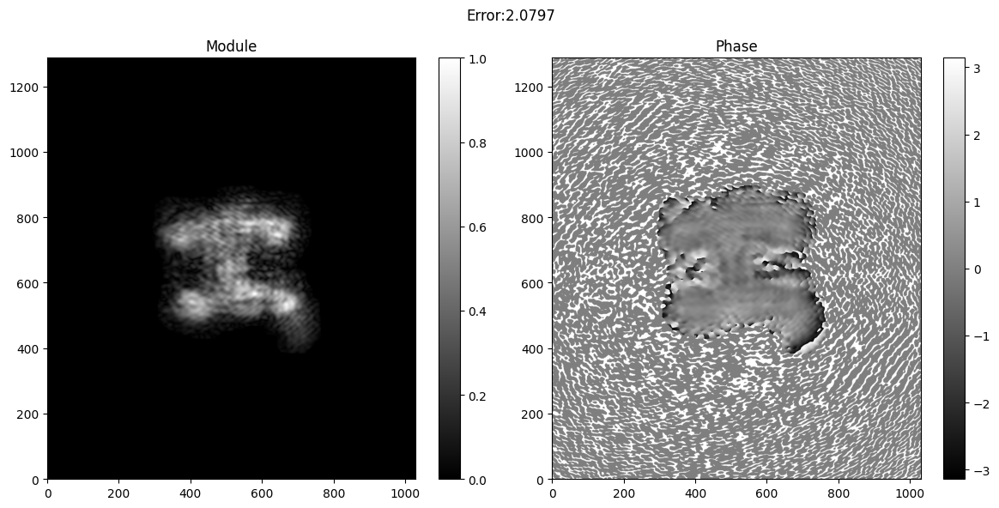

...

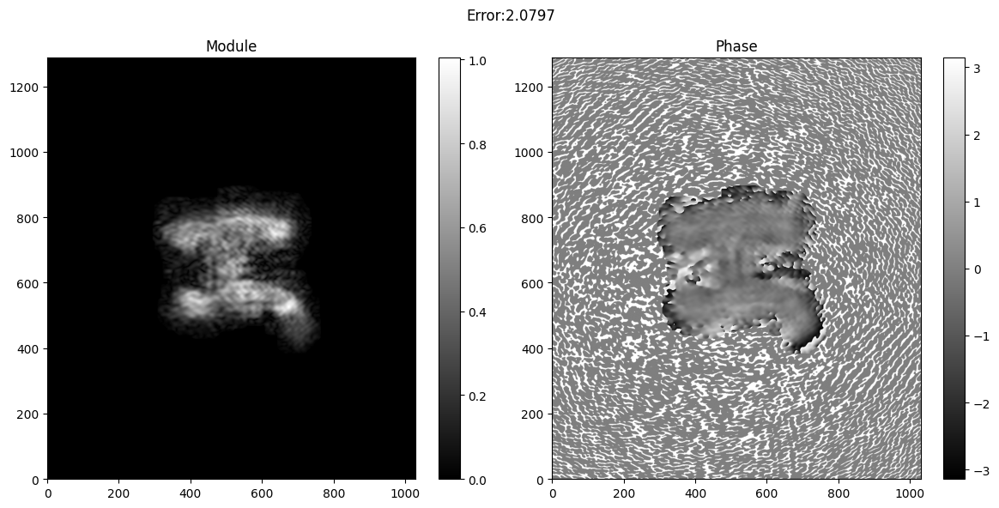

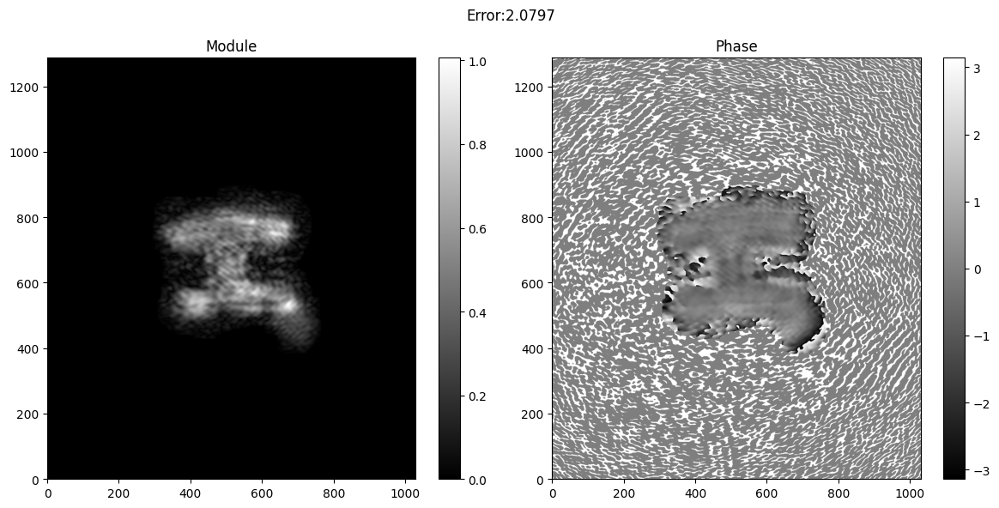

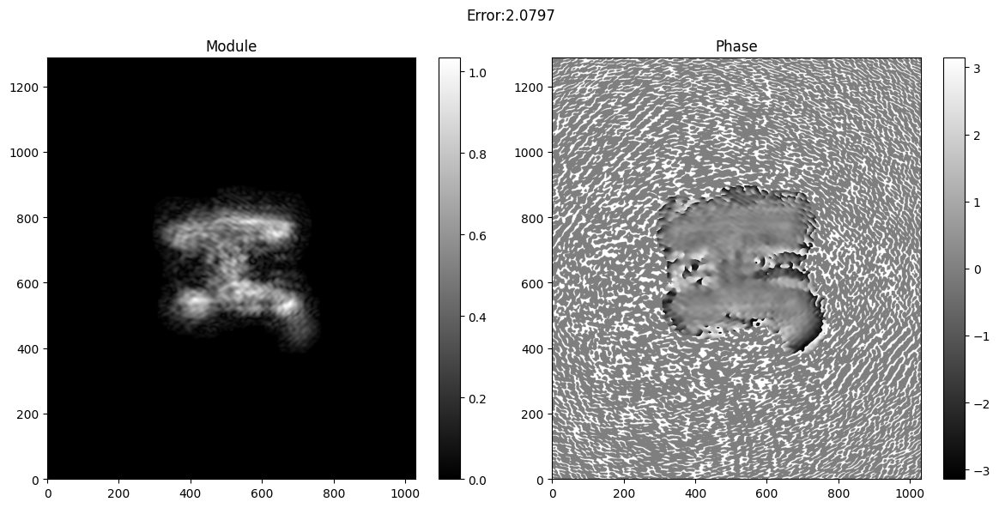

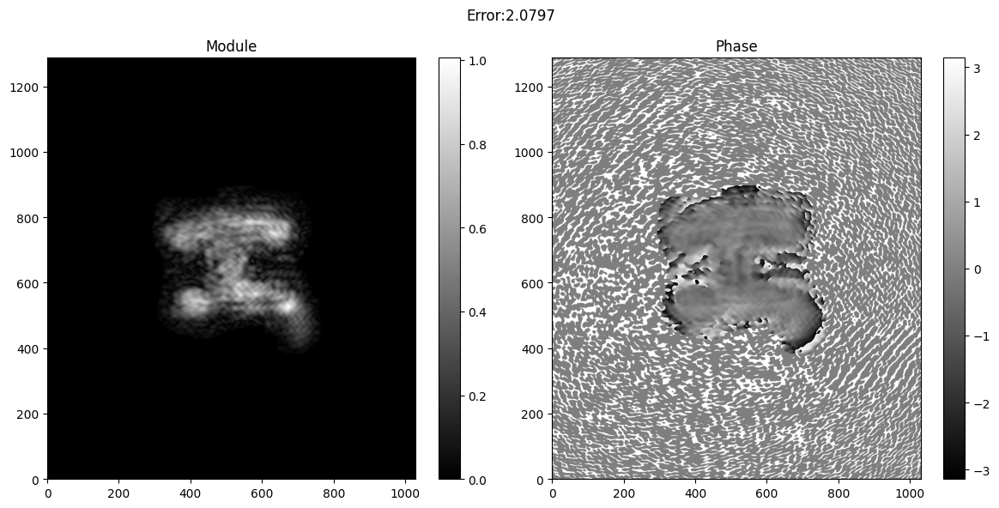

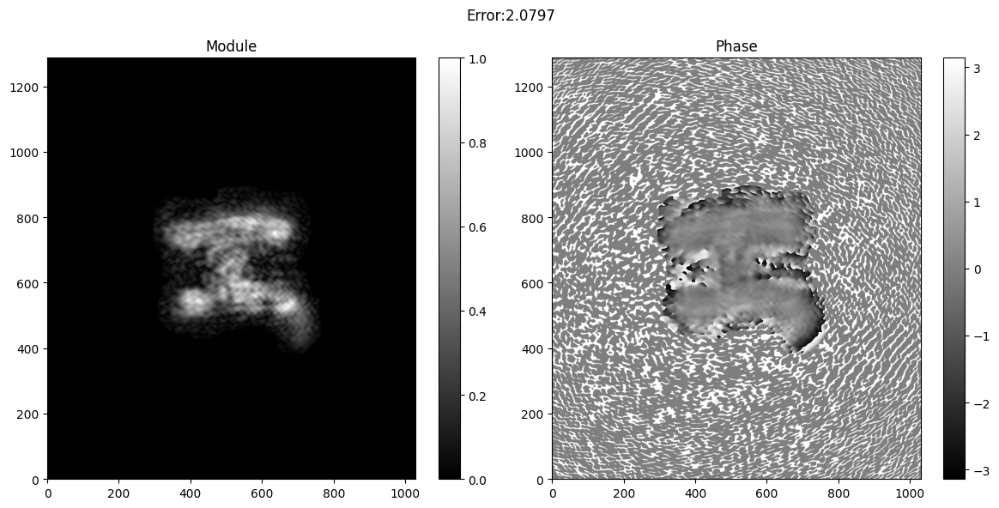

Продолжить? 0 - да, любое другое число - нет
0


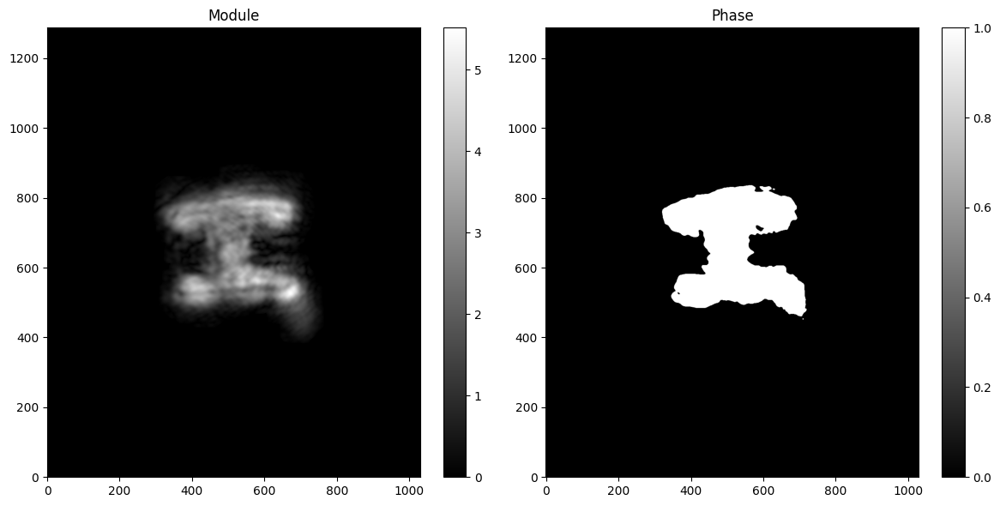

Число итераций эрозии:
1
Число итераций дилатации
20


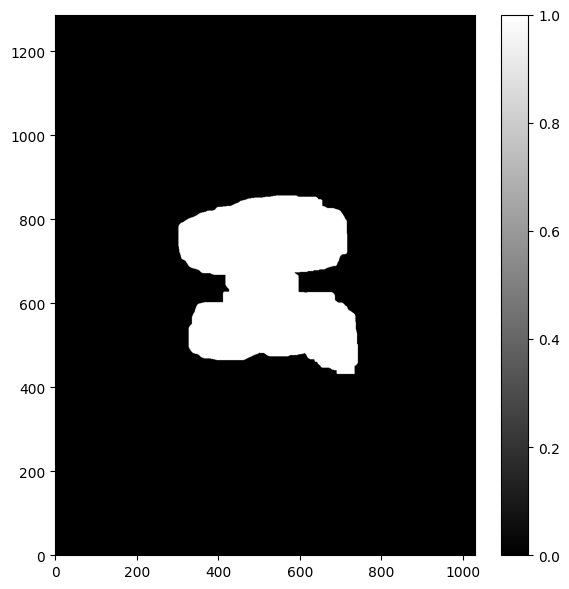

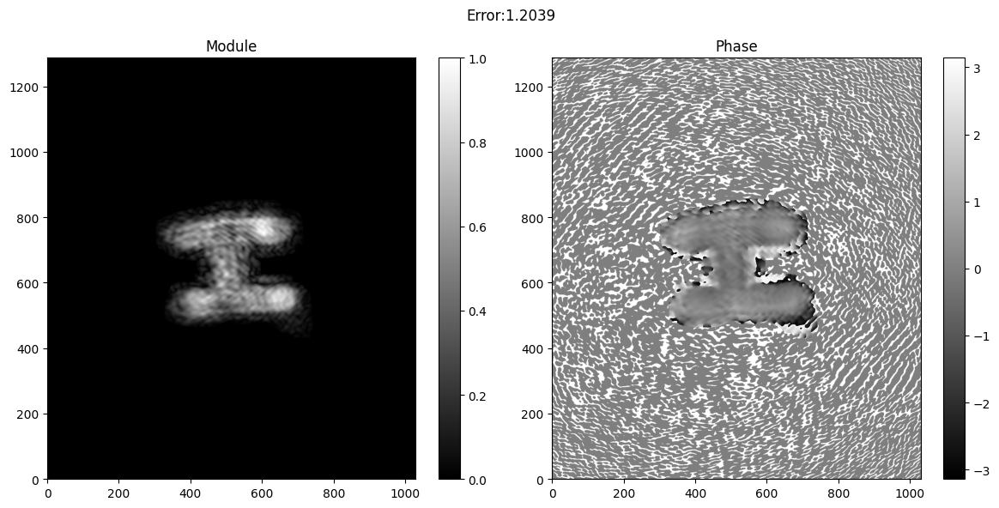

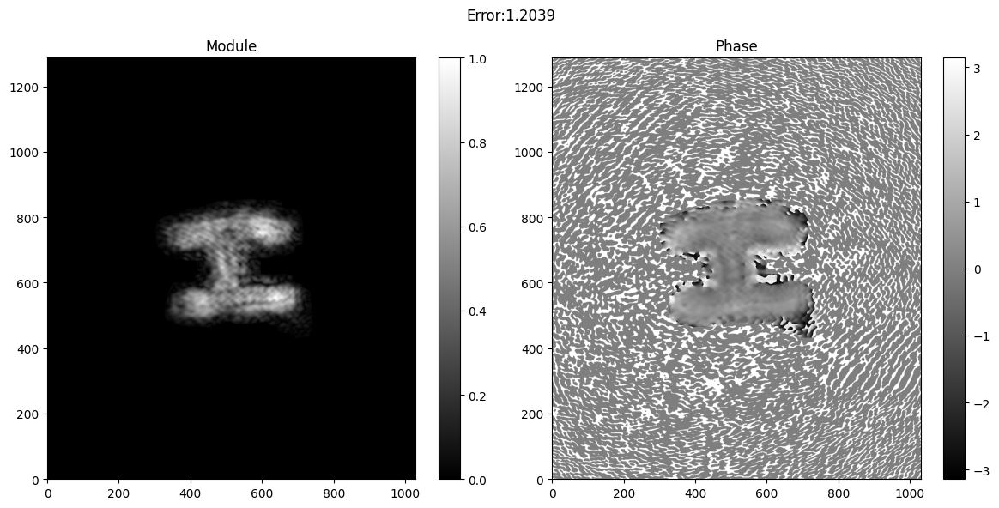

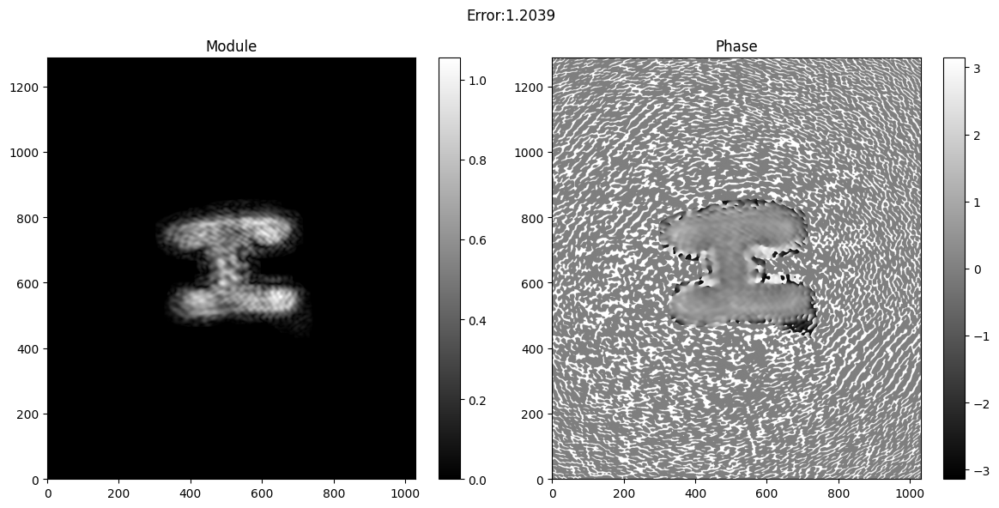

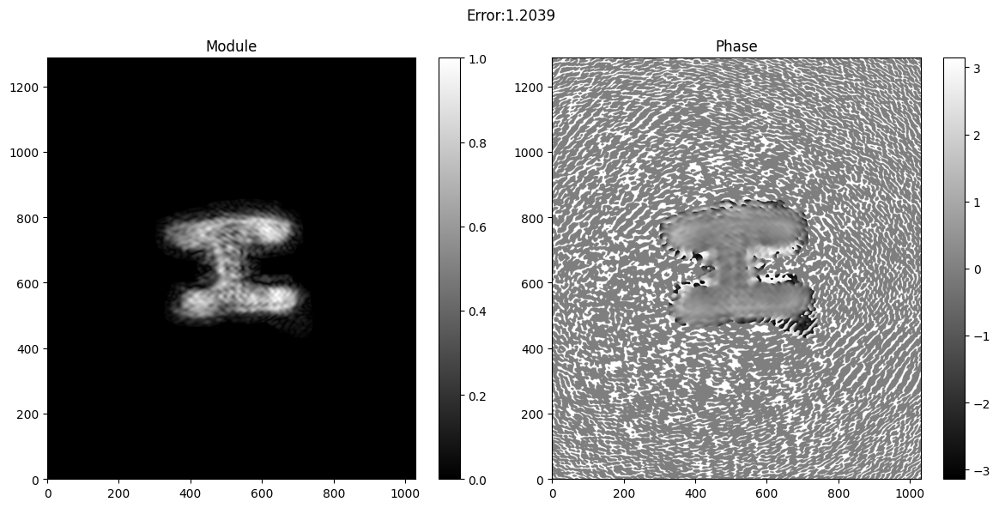

...

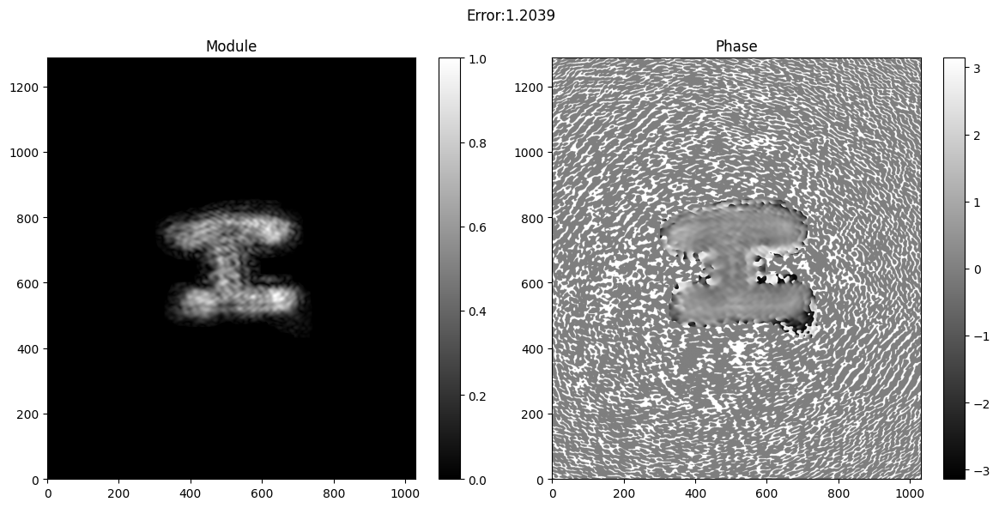

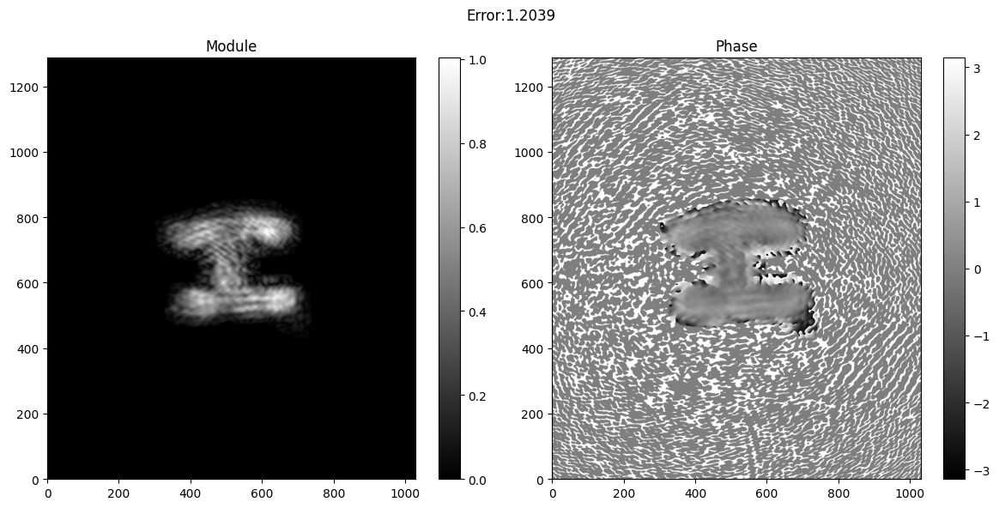

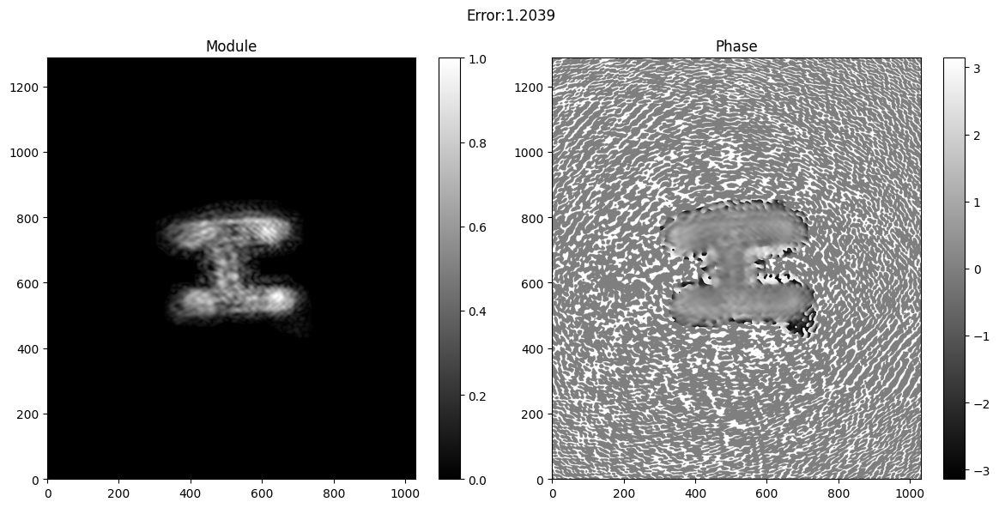

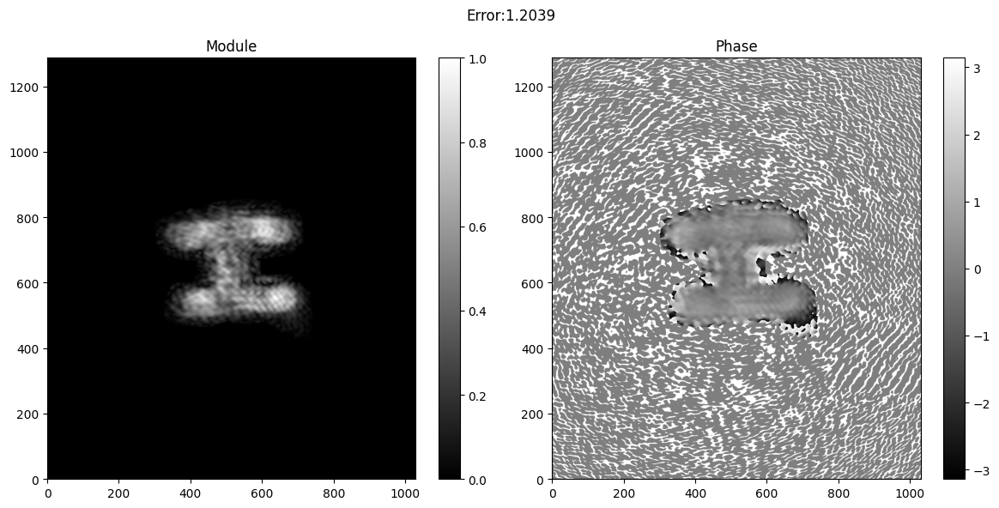

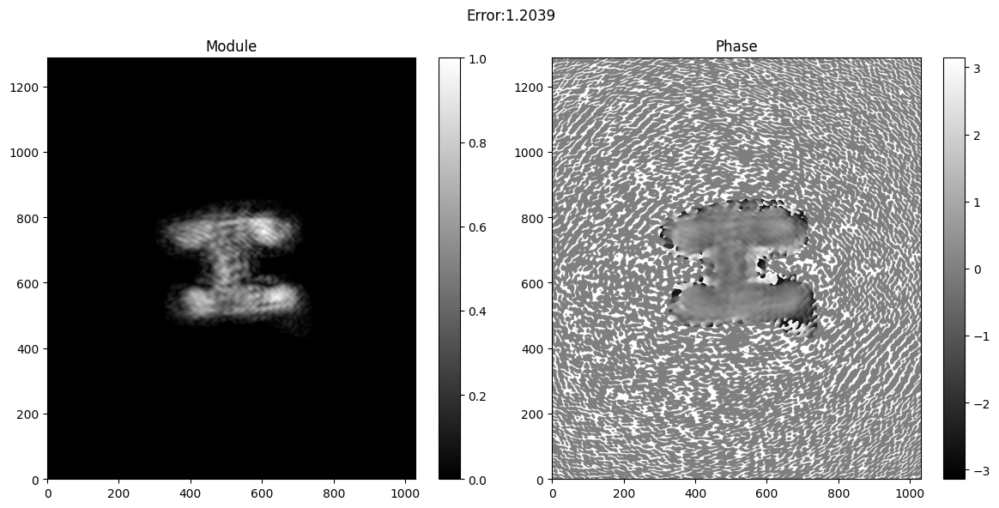

Продолжить? 0 - да, любое другое число - нет
0


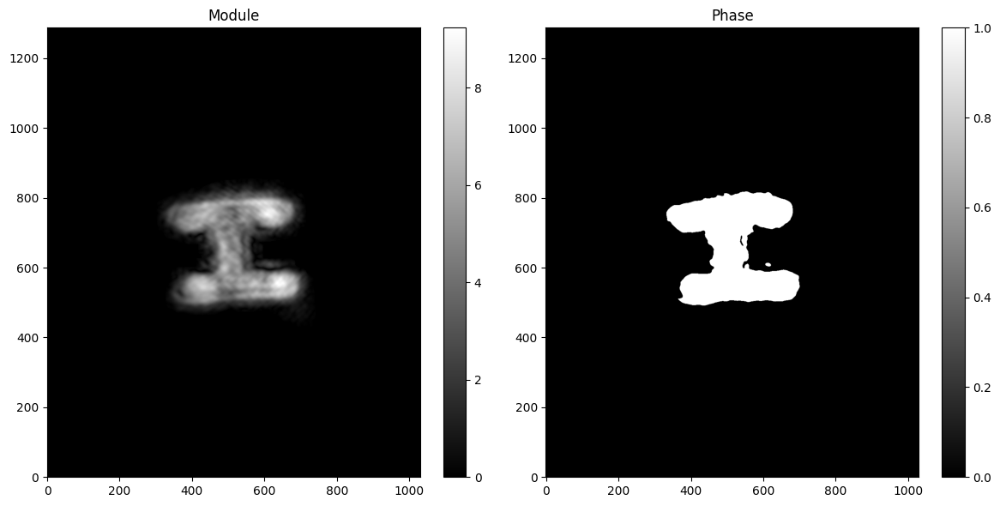

Число итераций эрозии:
5
Число итераций дилатации
20


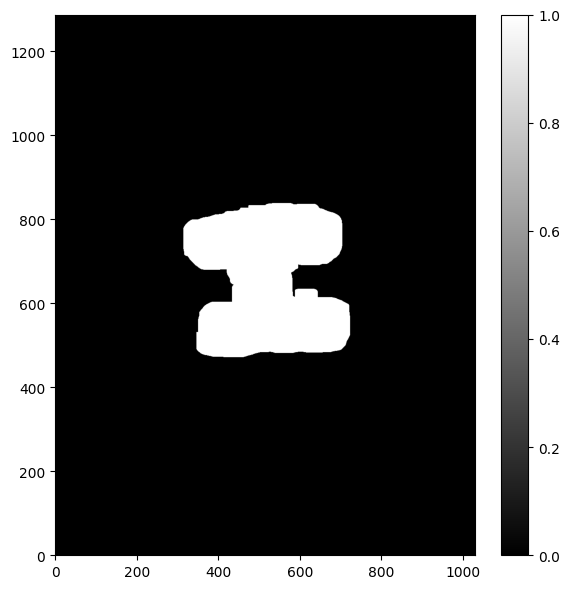

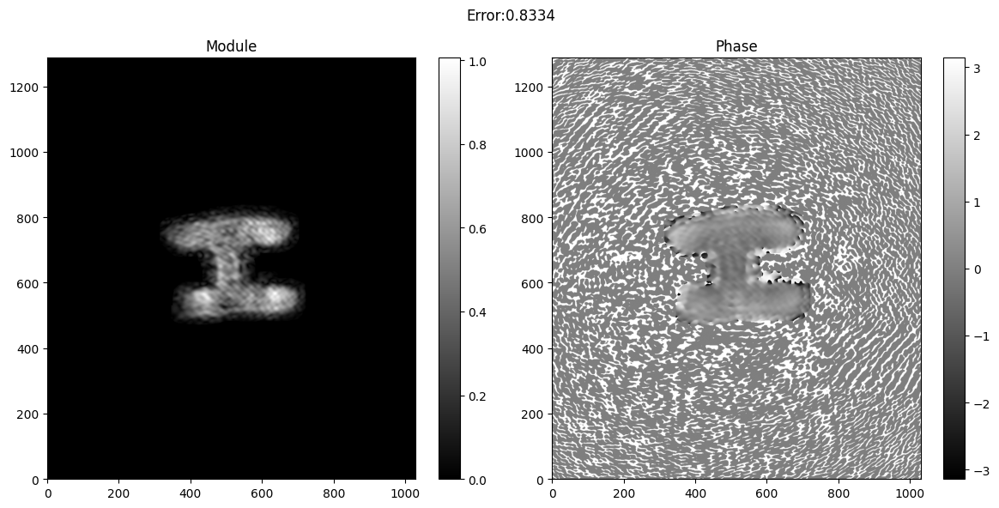

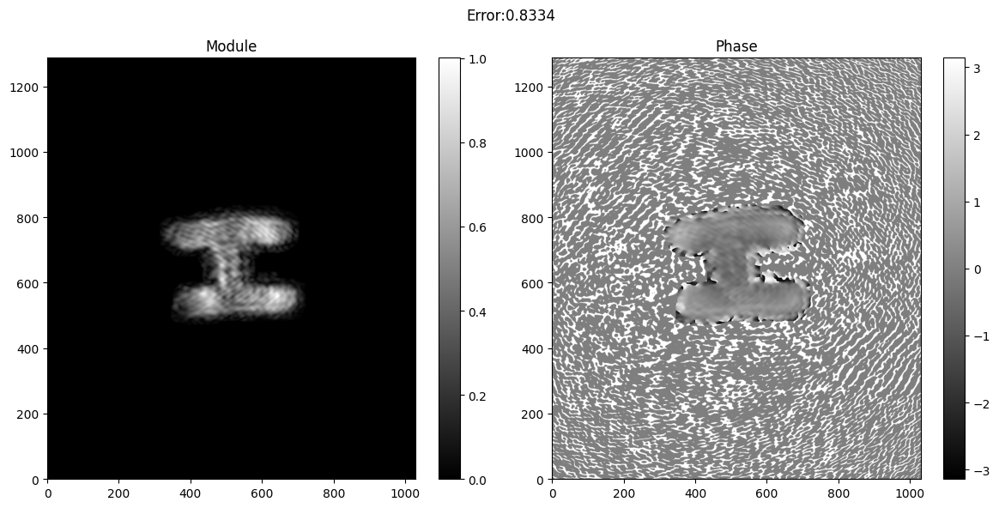

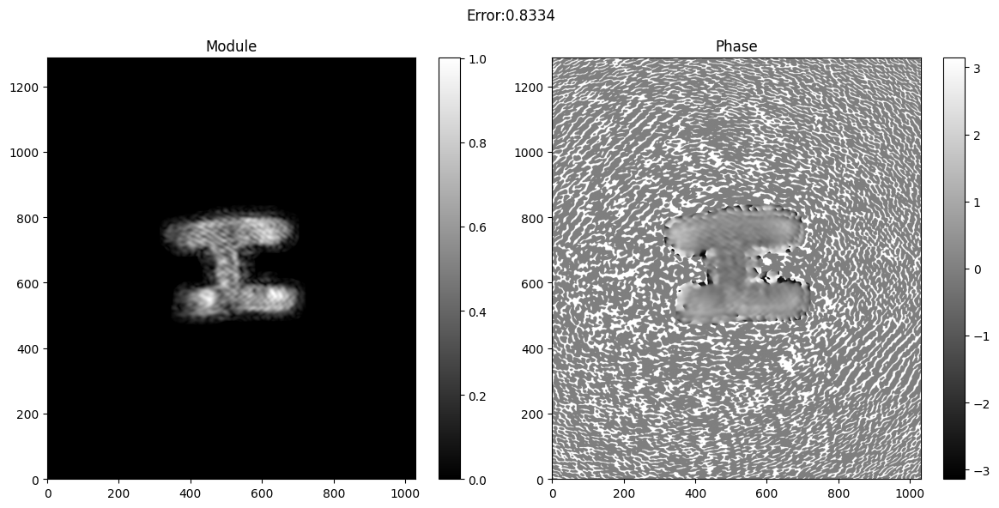

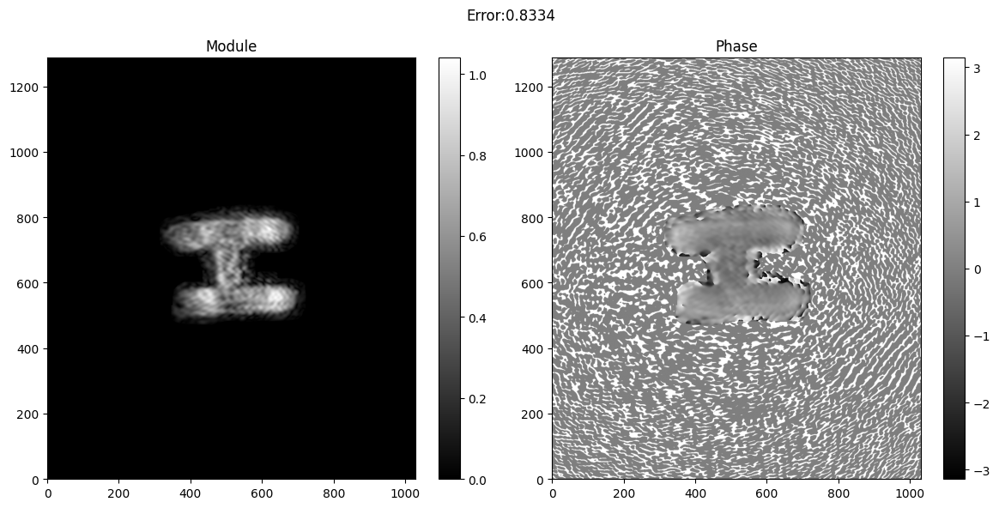

...

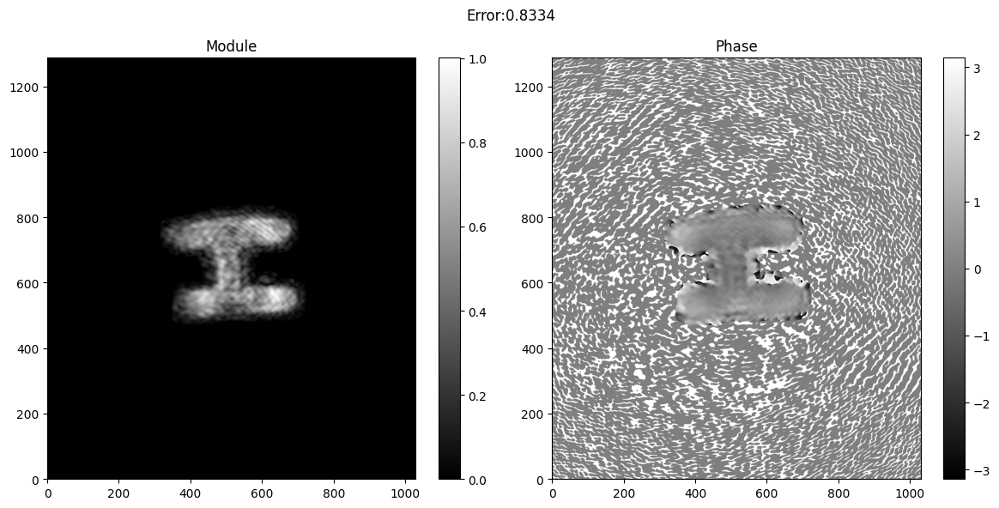

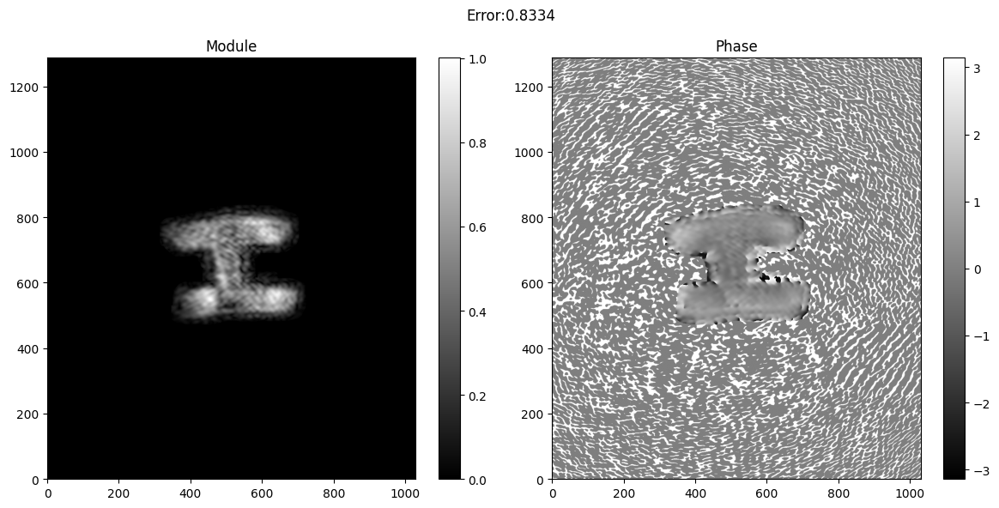

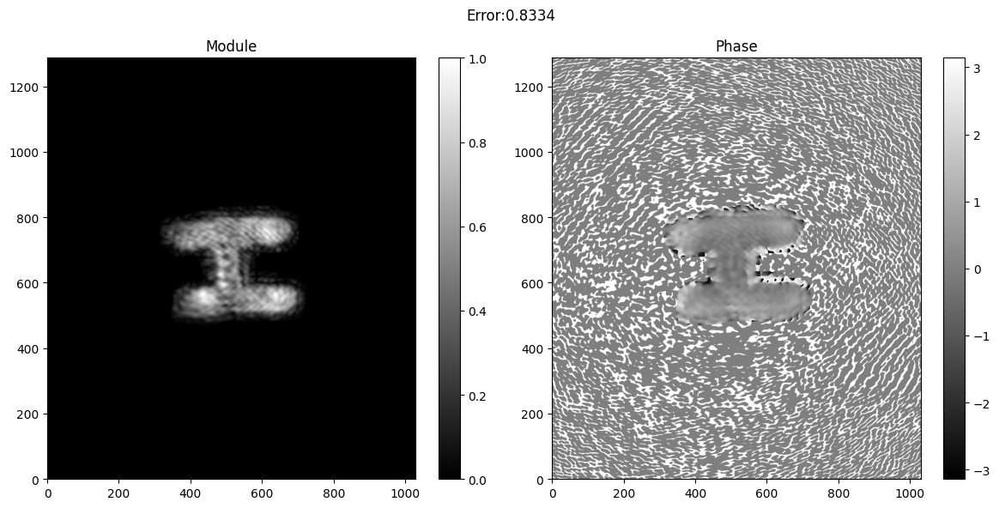

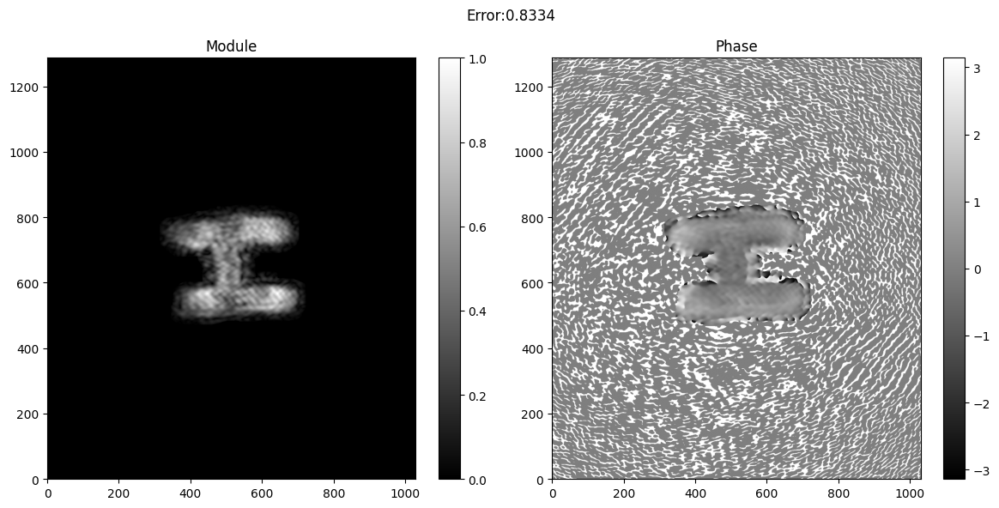

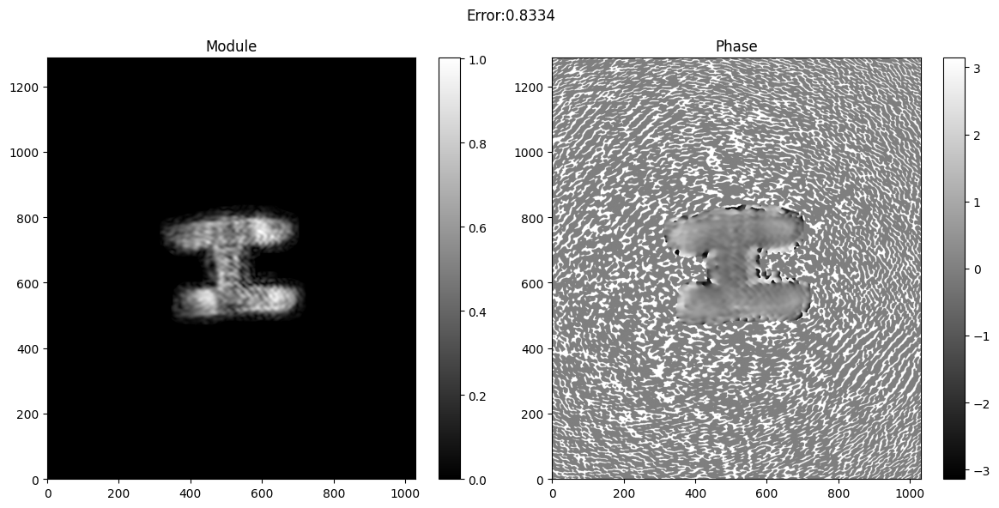

Продолжить? 0 - да, любое другое число - нет
1


In [8]:
from skimage.filters import threshold_otsu
def MAINFUNC(var_mask,vl:bool=True,show:bool=True):
  '''
  Main phase retrieval algorithm.

  Parameters:
    var_mask: inital mask
    vl: if True, HIO/ER uses virtual lens
    show: if True, shows each step of image reconstruction

   '''
  if vl:
    retrieved=VL_F
    det_dat=detector_F_data_vl
  else:
    retrieved=WP_F
    det_dat=detector_F_data_wp
  result, errors = retrieved.retr_block(
      detector=det_dat, initial_field=cp.abs(initial_field)*cp.asarray(var_mask),
      er_iters=10, MASK=var_mask)
  weighted_field=result/errors
  for i in range(10):
      result, errors = retrieved.retr_block(
      detector=det_dat, initial_field=np.abs(result)*cp.asnumpy(var_mask),
      er_iters=10,MASK=var_mask)
      weighted_field+=result/errors
      if show:
        show_2_images(np.abs(cp.asnumpy(result)),np.angle(cp.asnumpy(result)),suptitle=f"Error:{errors:.4f}")
  result, errors = retrieved.retr_block(
      detector=det_dat, initial_field=np.abs(result)*cp.asnumpy(var_mask),
      er_iters=200,MASK=var_mask)
  weighted_field+=result/errors
  if show:
      show_2_images(np.abs(cp.asnumpy(result)),np.angle(cp.asnumpy(result)),suptitle=f"Error:{errors:.4f}")

  return weighted_field

stop_arg=0
var_mask=F_processor.create_mask()
weighted_field=MAINFUNC(var_mask=var_mask,vl=True,show=True)
while stop_arg==0:
  threshold_val = threshold_otsu(np.abs(weighted_field)/np.max(np.abs(weighted_field)))
  threshold_img=np.where(np.abs(weighted_field)/np.max(np.abs(weighted_field))<threshold_val,0,1)
  show_2_images(data1=np.abs(cp.asnumpy(weighted_field)),data2=threshold_img)
  print("Число итераций эрозии:")
  mask_eroded=erode(cp.asarray(threshold_img),iterations=int(input()))
  print("Число итераций дилатации")
  mask_adapt=dilate(cp.asarray(threshold_img), iterations=int(input()))
  var_mask=cp.asarray(mask_adapt)
  show_1_image(data=np.abs(cp.asnumpy(mask_adapt)))
  weighted_field=MAINFUNC(var_mask=var_mask,vl=True,show=True)
  print("Продолжить? 0 - да, любое другое число - нет")
  stop_arg=int(input())


## Final step

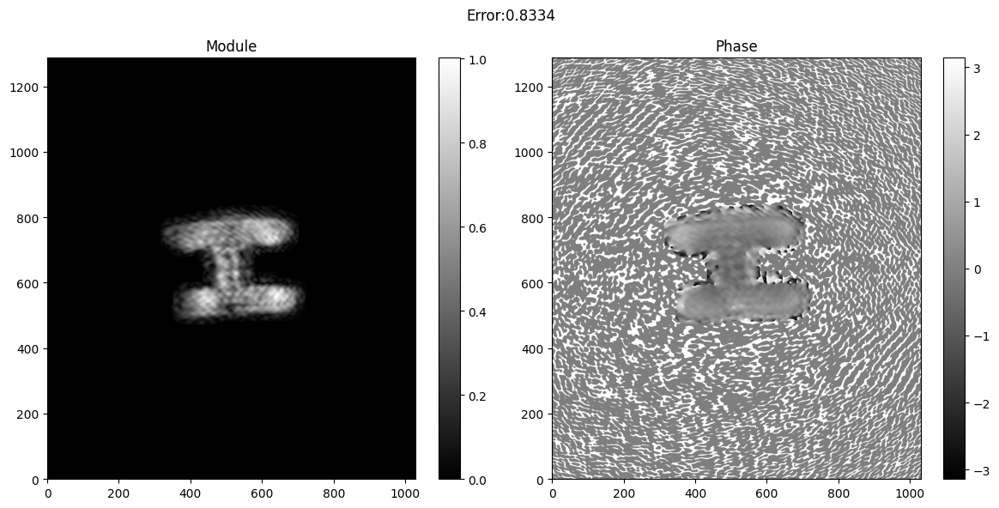

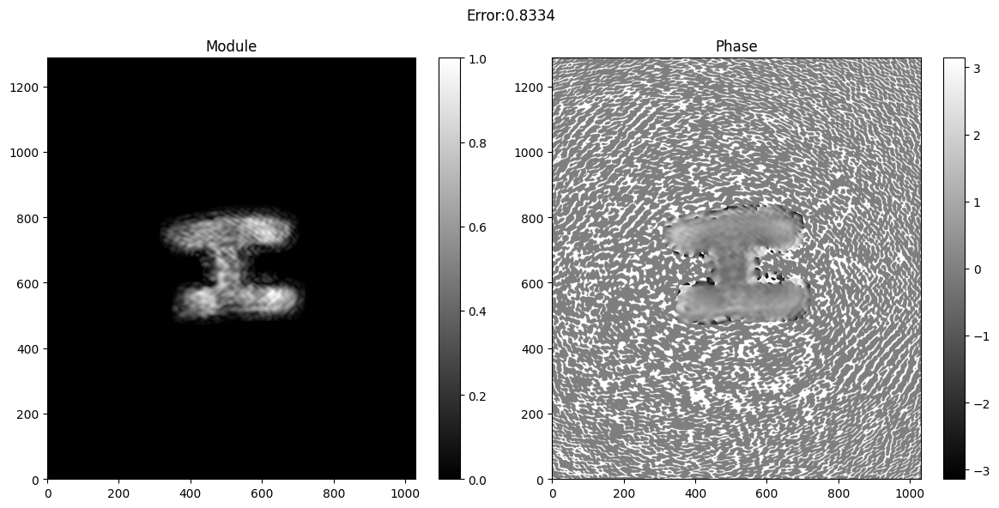

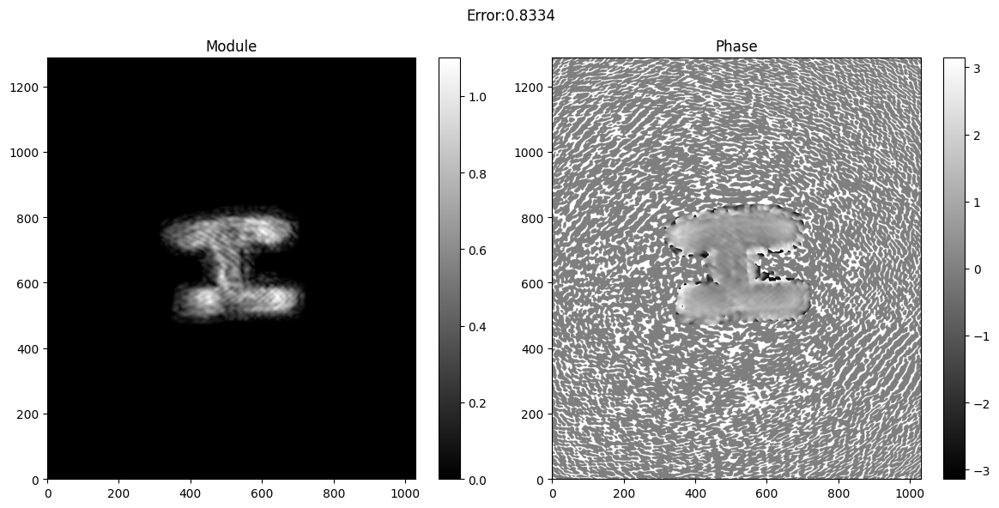

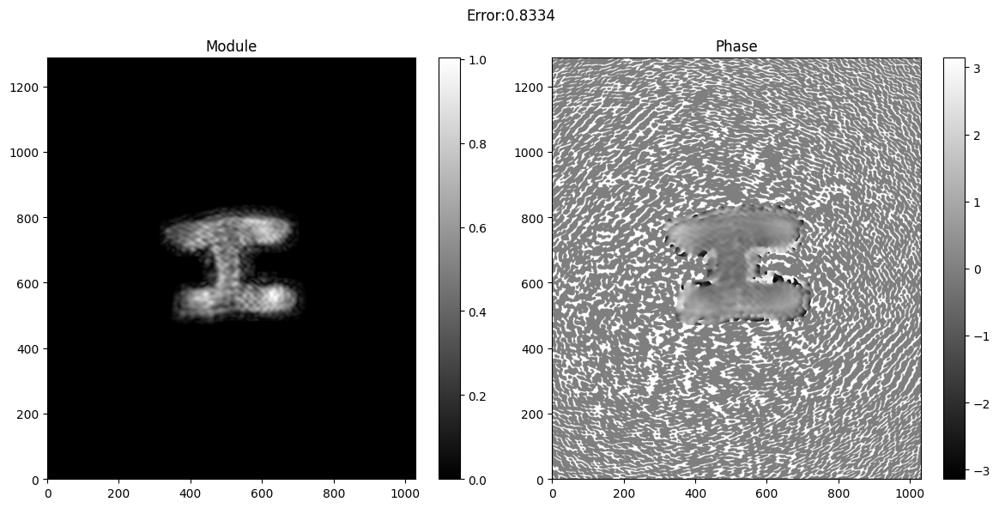

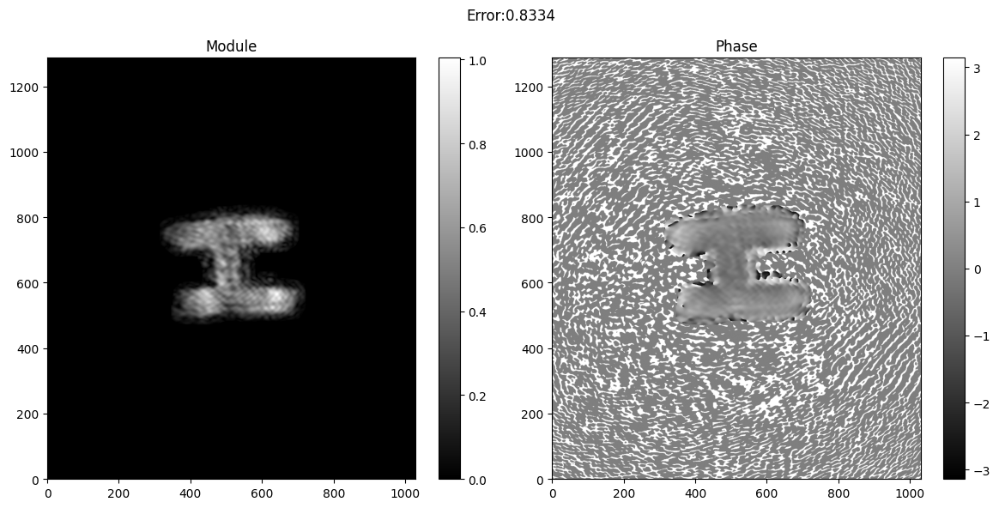

...

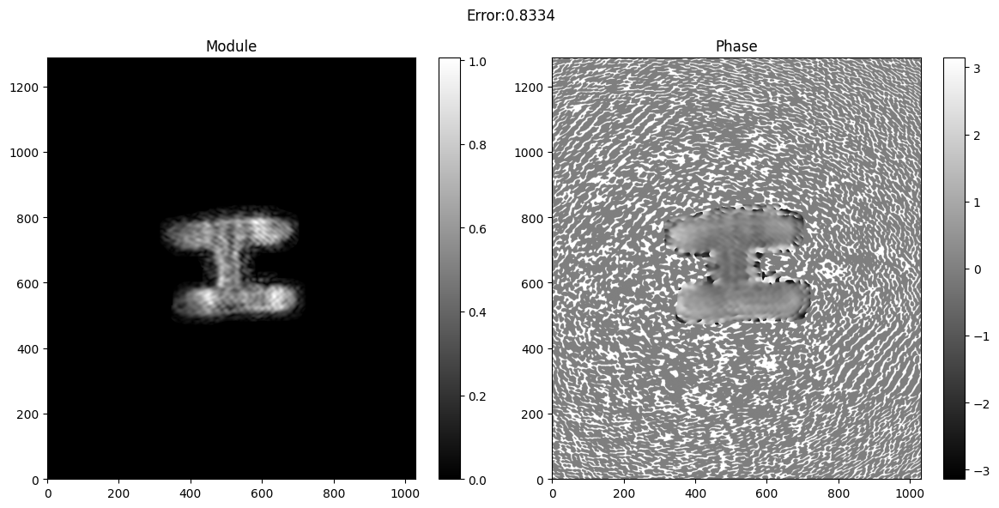

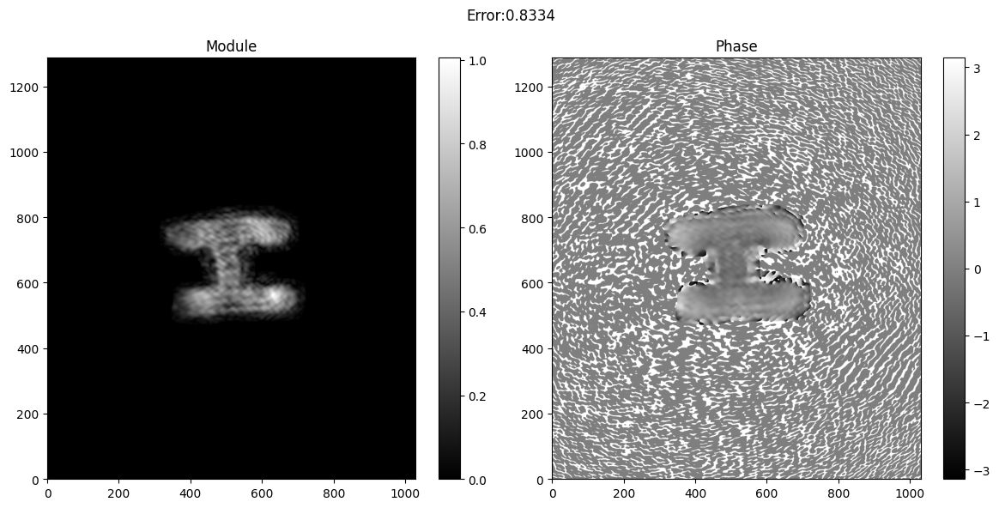

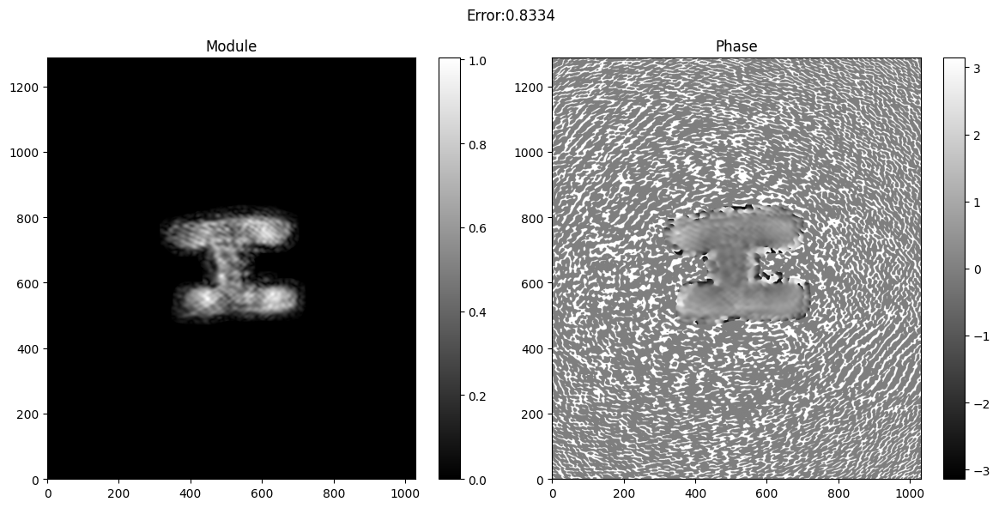

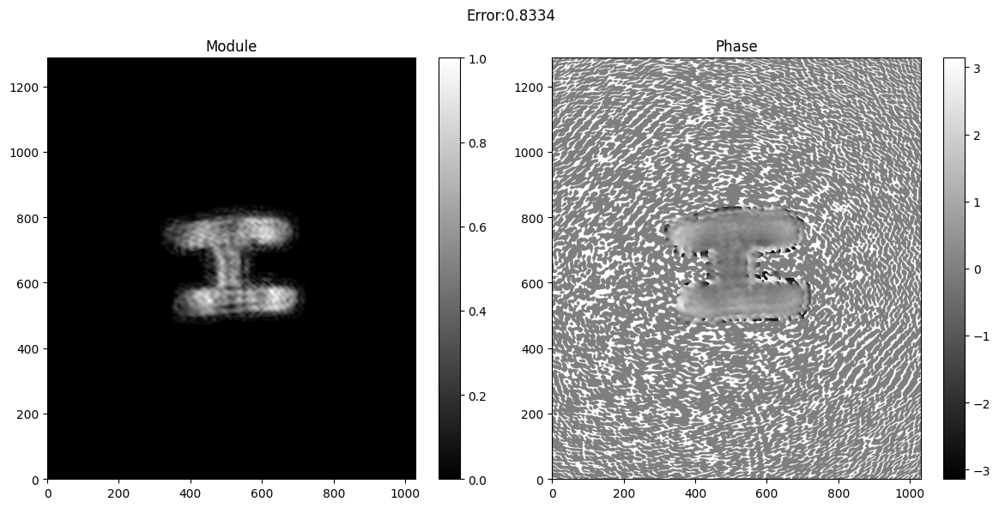

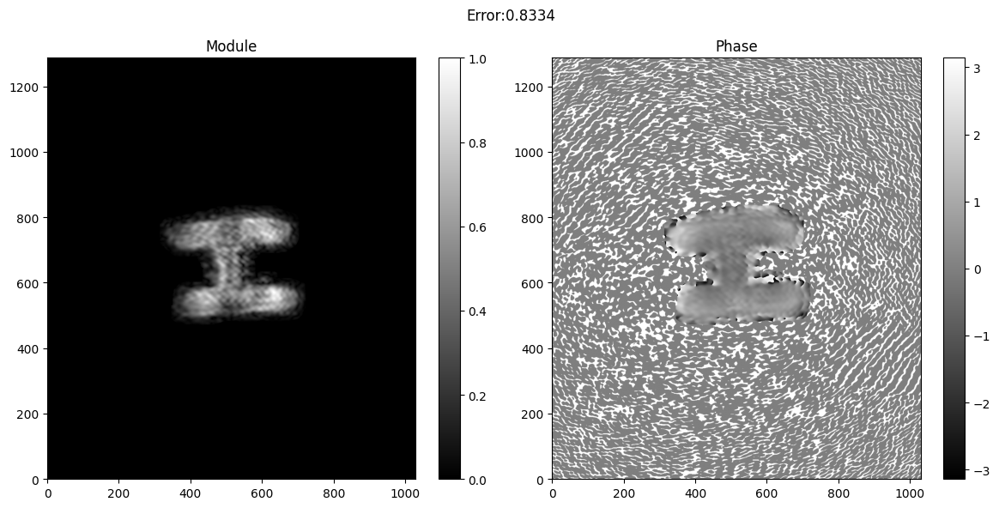

In [9]:
retrieved=VL_F #WP_F
det_dat=detector_F_data_vl#wp
initial_field = F_processor.generate_random_complex_field()
result, errors = retrieved.retr_block(detector=det_dat,
                                      initial_field=cp.abs(initial_field)*cp.asarray(var_mask),
                                      er_iters=10, MASK=var_mask)
for i in range(10):
  result, errors = retrieved.retr_block(detector=det_dat,
                                        initial_field=np.abs(result)*cp.asnumpy(var_mask),
                                        er_iters=10, MASK=var_mask)

  show_2_images(np.abs(cp.asnumpy(result)),np.angle(cp.asnumpy(result)),suptitle=f"Error:{errors:.4f}")

result, errors = retrieved.retr_block(detector=det_dat,
                                      initial_field=np.abs(result)*cp.asnumpy(var_mask),
                                      er_iters=200,MASK=var_mask)
show_2_images(np.abs(cp.asnumpy(result)),np.angle(cp.asnumpy(result)),suptitle=f"Error:{errors:.4f}")


## Stats (resources consumption)

In [10]:
cProfile.run('MAINFUNC(vl=True,show=False)','profile_stats')
stats = pstats.Stats('profile_stats')
stats.sort_stats('cumtime').print_stats(20)

TypeError: MAINFUNC() missing 1 required positional argument: 'var_mask'

In [ ]:
# old & simplier version of this code; can be useful for manual debugging

'''
def dilate(image, iterations=1, kernel_size=3):
    image_gpu = cp.asarray(image)
    kernel = cp.ones((kernel_size, kernel_size), dtype=bool)

    for _ in range(iterations):
        image_gpu = cndimage.binary_dilation(image_gpu, structure=kernel)

    return image_gpu

def erode(image, iterations=1, kernel_size=3):
    image_gpu = cp.asarray(image)
    kernel = cp.ones((kernel_size, kernel_size), dtype=bool)

    for _ in range(iterations):
        image_gpu = cndimage.binary_erosion(image_gpu, structure=kernel)

    return image_gpu
### IMAGE PREPARATION ###

image_path = "4.tif"
crypt = Image.open(image_path)

# Width must be 1030 height 1288
crypt = crypt.rotate(90, expand=True)
crypt_array = np.array(crypt)
crypt_array = np.flipud(crypt_array)
print("Type:", crypt_array.dtype)  #uint16

noise=85
# if value > noise, write value-nose, else write 0
crypt_values = np.where(crypt_array < noise, 0, crypt_array-noise)

#square root of intensity
crypt_values=np.sqrt(crypt_values)
crypt_values=crypt_values.astype(np.complex128)

# Check for correct noise removal
print("Min value:", np.min(crypt_values))
print("Max value:", np.max(crypt_values))

# Size check
Height, Width= crypt_values.shape

print("Width: ", Width, "Height: ", Height) #Width: 1030 Height: 1288

#######################################

### EXPERIMENTAL VALUES ###

Z=60*10*1000 #um
Lambda=632.8/1e3 #nm->um
K=2.*np.pi/Lambda

#mask_width_um = 2.3 * 1000  # 2300 um
#mask_height_um = 2.2 * 1000  # 2200 um
mask_width_um = 2700
mask_height_um = 3200


# detector size (в um)
det_width_um = 0.618 * 10 * 1000  # 6180 um
det_height_um = 0.7728 * 10 * 1000  # 7728 um

# grid step (um/px)
dx = det_width_um / Width
dy = det_height_um / Height

#######################################

### MASK CREATION ###

mask_width = int(mask_width_um /dx) #px
mask_height = int(mask_height_um /dy) #px

offset = 0#17 #px
Mask = np.zeros((Height, Width), dtype=np.float64)

center_x = Width // 2
center_y = Height // 2-offset

start_x = center_x - (mask_width // 2)
start_y = center_y - (mask_height // 2)

Mask[start_y:start_y + mask_height, start_x:start_x + mask_width] = 1.0
Antimask = 1.0 - Mask
mask_ex=np.zeros((Height, Width),dtype=np.float64)
mask_ex[start_y:start_y+int(2300/6),start_x:start_x+int(2200/6)]=1.0
#######################################

### VIRTUAL LENS ###

#Formula (9)
#crypt_values=crypt_values*Z/(2.*np.pi*K)

x_grid = (np.arange(Width) - (Width // 2)) * dx
y_grid = (np.arange(Height) - (Height // 2)+offset) * dy
X, Y = np.meshgrid(x_grid, y_grid)
r_squared = X**2 + Y**2
r_squared=cp.asarray(r_squared)

Exp_ph=cp.exp(1j*K*r_squared/(2*Z))
Exp_ph_c=cp.exp(-1j*K*r_squared/(2*Z))

def affine_scale(img, kx, ky,d=offset):
    h, w = img.shape
    # Матрица масштабирования (учитывает центр изображения)
    matrix = cp.array([[ky, 0], [0, kx]])
    offset = cp.array([h, w]) * (1 - cp.array([ky, kx])) // 2-cp.array([d,0])
    return cndimage.affine_transform(img, matrix, offset=offset,order=5, output_shape=(h, w))

A_x, A_y = (Lambda*Z)/(det_width_um*dx),(Lambda*Z)/(det_height_um*dy)
#crypt_values=affine_scale(cp.asarray(crypt_values),A_x,A_y)
################################

### RANDOM FIELD ###

def generate_random_complex_field(height=Height,width=Width):
    #height,width=Size
    rand_field = np.empty((height, width), dtype=np.complex64)
    amplitudes = np.empty((height, width))
    phases = np.empty((height, width))
    for i in prange(height):
        for j in range(width):
            amplitudes[i,j] = secrets.randbits(32) / 2**32
            phases[i,j] = secrets.randbits(32) / 2**32 * 2 * np.pi
    rand_field = amplitudes * np.exp(1j * phases)
    return rand_field

### FFT&IFFT ###

def FT(data):
    data_gpu = cp.asarray(data)
    data_gpu = cp.fft.ifftshift(data_gpu)
    result_gpu = cp.fft.fft2(data_gpu)
    result_gpu = cp.fft.fftshift(result_gpu)
    return result_gpu

def IFT(data):
    data_gpu = cp.asarray(data)
    data_gpu = cp.fft.ifftshift(data_gpu)
    result_gpu = cp.fft.ifft2(data_gpu)
    result_gpu = cp.fft.fftshift(result_gpu)
    return result_gpu

#######################################


def prop(field, z):
    field_1 = FT(field)
    field_1 = cp.fft.ifftshift(field_1)
    n, m = field_1.shape
    fx = cp.fft.fftfreq(n)
    fy = cp.fft.fftfreq(m)
    px, py = cp.meshgrid(fx, fy, indexing='ij')
    p_squared = px**2 + py**2
    field_1 = field_1 * cp.exp(1j * z * cp.sqrt(K**2 - p_squared))
    field_1 = cp.fft.ifftshift(field_1)
    field_1=IFT(field_1)
    return field_1

#crypt_values=crypt_values*Z/(2.*np.pi*K)
#show_2_images(np.abs(cp.asnumpy(prop_det)),np.angle(cp.asnumpy(prop_det)))

### PROJECTOR ###

def steps(Detector, Num_field,virt_lens:bool=False):
    X_1=cp.asarray(Num_field)
    if virt_lens:
        X_2=FT(X_1*Exp_ph)
    else:
        X_2=prop(X_1,Z)
    X_2=X_2/cp.max(X_2)
    X_3=cp.asarray(Detector)*X_2/cp.abs(X_2)
    if virt_lens:
        X_4=IFT(X_3)/Exp_ph
    else:
        X_4=prop(X_3,-Z)
    X_out=X_4/cp.max(X_4)
    return X_out

def apply_mask2field(msk,fld):
    mask=cp.asarray(msk)
    field=cp.asarray(fld)
    return (mask*field)

#######################################

### ER ###
def ER(N_iter: int, field, detector):
    A =field  # 0th iteration --- random field distribution or the previous result
    for i in range(N_iter):
        D = steps(Detector=detector,Num_field=A)
        A=apply_mask2field(msk=Mask,fld=D)
    D_norm = cp.linalg.norm(D)
    A_norm = cp.linalg.norm(A)
    Error = cp.sqrt(D_norm**2 - A_norm**2) / D_norm
    return [A, Error]
##########

### HIO ###
def HIO(N_iter: int, beta: float, field, detector):
    A = cp.asarray(field)  # 0th iteration --- random field distribution or the previous result
    for i in range(N_iter):
        D = steps(Detector=detector,Num_field=A)
        A = apply_mask2field(msk=Mask,fld=D) + apply_mask2field(msk=Antimask, fld=(A - beta * D))  # r-domain
    return A
###########

def retrieving(DET, FLD, beta,N):
    # FLD is the r-domain field for the HIO's 0th iteration, DET --- detector's magnitude
    c_hio = HIO(N_iter=30, beta=beta, field=FLD, detector=DET)
    # c_hio field (in r-domain), now put it into 0th iteration for ER
    c_er,err = ER(N_iter=N, field=c_hio, detector=DET)
    return [c_er,err]

def retr_block(input_field,det=crypt_values,N=10):
    out1,err1 = retrieving(DET=det,FLD=input_field, beta=1.,N=N)
    out2,err2 = retrieving(DET=det,FLD=(out1),beta=0.7,N=N)
    out3,err3 = retrieving(DET=det,FLD=(out2),beta=0.4,N=N)
    out4,err4 = retrieving(DET=det,FLD=(out3),beta=0.1,N=N)
    return [out4,err4]

#animation_frames=[]
error=1.0
while error>=0.05:
    random_field = generate_random_complex_field()
    field_1, error = retr_block(np.abs(random_field)*Mask)
    FielD=field_1/error
    #frame=silent_show_2_images(data1=np.abs(cp.asnumpy(field_1)),data2=np.angle(cp.asnumpy(field_1)),suptitle=f"Error:{error:.4f}")
    #animation_frames.append(frame)
    for i in range (10):
        treshold_m = cp.where(cp.abs(field_1) < 0.9, 0, 1)
        field_1, error = retr_block(cp.abs(field_1)*cp.asarray(Mask),N=30)#*treshold_m,N=30)#
        FielD+=field_1/error
        print(error)
        show_2_images(data1=np.abs(cp.asnumpy(field_1)),data2=np.angle(cp.asnumpy(field_1)),suptitle=f"Error:{error:.4f}")
        #frame=silent_show_2_images(data1=np.abs(cp.asnumpy(field_1)),data2=np.angle(cp.asnumpy(field_1)),suptitle=f"Error:{error:.4f}")
        #animation_frames.append(frame)

    treshold_m = cp.where(cp.abs(field_1) < 0.9, 0, 1)
    field_1, error = retr_block(cp.abs(field_1)*cp.asarray(Mask),N=200)#treshold_m,N=200)
    FielD+=field_1/error
    threshold_img=cp.where(cp.abs(FielD)/cp.max(cp.abs(FielD))<0.3,0,1)
    mask_eroded=erode(threshold_img,iterations=5)
    mask_adapt=dilate(threshold_img, iterations=40)
    Mask=cp.asnumpy(mask_adapt)
    Antimask=1-cp.asnumpy(mask_adapt)
    print(error)
    show_2_images(data1=np.abs(cp.asnumpy(field_1)),data2=np.angle(cp.asnumpy(field_1)),suptitle=f"Error:{error:.4f}")
    show_2_images(data1=np.abs(cp.asnumpy(mask_adapt)),data2=mask_ex)
    #frame=silent_show_2_images(data1=np.abs(cp.asnumpy(field_1)),data2=np.angle(cp.asnumpy(field_1)),suptitle=f"Error:{error:.4f}")
    #animation_frames.append(frame)

#make_animation(animation_frames, output_path='WP.gif', fps=5)
'''

In [ ]:
# GIF #
from matplotlib.backends.backend_agg import FigureCanvasAgg as FigureCanvas
import imageio


def silent_show_2_images(data1, data2, **kwargs):
    """Версия show_2_images без отображения окна"""
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=kwargs.get('figsize', (12, 6)))

    # Используем оригинальную логику отрисовки
    plot_image(data1, ax=ax1,
              title=kwargs.get('title1', 'Module'),
              cmap=kwargs.get('cmap1', 'grey'),
              **kwargs)

    plot_image(data2, ax=ax2,
              title=kwargs.get('title2', 'Phase'),
              cmap=kwargs.get('cmap2', 'grey'),
              **kwargs)

    if 'suptitle' in kwargs:
        fig.suptitle(kwargs['suptitle'])

    plt.tight_layout()

    # Рендерим в numpy массив вместо показа
    canvas = FigureCanvas(fig)
    canvas.draw()
    image = np.array(canvas.renderer.buffer_rgba())
    plt.close(fig)

    # Конвертируем RGBA в RGB
    return image[..., :3]

def make_animation(frames, output_path='VL.gif', fps=10):
    """Создает GIF из списка кадров"""

    duration = 1000 / fps  # в миллисекундах на кадр
    imageio.mimsave(output_path, frames, duration=duration, loop=0)
'''
def makegif(vl:bool=True):
  if vl:
    retrieved=VL_F
    det_dat=detector_F_data_vl
  else:
    retrieved=WP_F
    det_dat=detector_F_data_wp
  animation_frames = []
  result, errors = retrieved.retr_block(
      detector=det_dat,
      initial_field=cp.abs(initial_field))
  frame = silent_show_2_images(np.abs(cp.asnumpy(result)),
                            np.angle(cp.asnumpy(result)),
                            suptitle=f"Iter=0,Error:{errors:.4f}")
  animation_frames.append(frame)
  for i in range(20):
    result, errors = retrieved.retr_block(
    detector=det_dat,
    initial_field=result,er_iters=30)
    frame = silent_show_2_images(np.abs(cp.asnumpy(result)),
                                np.angle(cp.asnumpy(result)),
                                suptitle=f"Iter={i+1},Error:{errors:.4f}")
    animation_frames.append(frame)

  result, errors = retrieved.retr_block(
  detector=det_dat,
  initial_field=result,er_iters=200)
  frame = silent_show_2_images(np.abs(cp.asnumpy(result)),
                            np.angle(cp.asnumpy(result)),
                            suptitle=f"Iter={21},Error:{errors:.4f}")
  animation_frames.append(frame)
  # Создаем анимацию
  make_animation(animation_frames, output_path='VL.gif', fps=5)

makegif(vl=True)
'''